<a href="https://colab.research.google.com/github/c-daly/Notebooks/blob/main/GensimW2V.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [2]:
!pip install --upgrade gensim

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 24.1 MB 144.5 MB/s 
  Attempting uninstall: gensim
    Found existing installation: gensim 3.6.0
    Uninstalling gensim-3.6.0:
      Successfully uninstalled gensim-3.6.0


In [3]:
import nltk
from nltk.corpus import stopwords
from nltk.stem import PorterStemmer
from nltk.tokenize import word_tokenize
import string
import pandas as pd
import re
import nltk
import timeit
nltk.download('omw-1.4')
nltk.download('stopwords')
nltk.download('wordnet')
nltk.download('words')

stopword = nltk.corpus.stopwords.words('english')
wn = nltk.WordNetLemmatizer()
ps = nltk.PorterStemmer()
words = set(nltk.corpus.words.words())

# From the first assignment
def clean_text(text):
    text = text.lower()
    text = re.sub(r"http\S+", "", text)
    text = re.sub(r"www.\S+", "", text)
    text_links_removed = "".join([char for char in text if char not in string.punctuation])
    text_cleaned = " ".join([word for word in re.split('\W+', text_links_removed)
        if word not in stopword])
    text = " ".join([wn.lemmatize(word) for word in re.split('\W+', text_cleaned)])
    
    return text

[nltk_data] Downloading package omw-1.4 to /root/nltk_data...
[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Unzipping corpora/stopwords.zip.
[nltk_data] Downloading package wordnet to /root/nltk_data...
[nltk_data] Downloading package words to /root/nltk_data...
[nltk_data]   Unzipping corpora/words.zip.


In [8]:
import gensim.downloader as api
from gensim.models.word2vec import Word2Vec

corpus = api.load('text8')

# this dataset doesn't require
# cleaning.  A couple early tests
# made use of it.
def generate_corpus():
  #cleaned_corpus = []
  #for line in corpus:
  #  cleaned_text = clean_text(" ".join(line))
  #  cleaned_corpus.append(cleaned_text)
  #return cleaned_corpus
  return corpus

#cleaned_corpus = generate_corpus()

In [9]:
from gensim.models.callbacks import CallbackAny2Vec

models_loss_per_epoch = []

class ModelStatistics():
  loss_per_epoch = []
  def __init__(self):
    loss_per_epoch = [] 

current_model_stats = ModelStatistics()

class callback(CallbackAny2Vec):
    '''Callback to print loss after each epoch.'''

    def __init__(self):
        self.epoch = 0
        self.last_loss = 0
        #current_model_stats.loss_per_epoch = []

    def on_epoch_end(self, model):
        loss = model.get_latest_training_loss()
        loss_now = loss - self.last_loss
        self.last_loss = loss
        current_model_stats.loss_per_epoch.append(loss_now)
        print('Loss after epoch {}: {}'.format(self.epoch, loss_now))
        self.epoch += 1

In [127]:
from timeit import default_timer as timer
from os.path import exists
import gensim
from gensim.test.utils import datapath
import matplotlib.pyplot as plt
import random

GLOBAL_OVERWRITE = True

from sklearn.decomposition import IncrementalPCA    # inital reduction
from sklearn.manifold import TSNE                   # final reduction
import numpy as np                                  # array handling


class TestHarness():
  def __init__(self, model_params=None):
    self.corpus = generate_corpus()
    self.execution_times = {}
    self.loss_per_epoch = [] 
    self.models = {}
    self.reduced_xy = {}
    self.model_args = {}
    self.analogy_results = {}
    current_model_stats.loss_per_epoch = []

    if model_params is not None:
      self.model_params = model_params
      for name, args in model_params:
        self.model_args[name] = args

  def reduce_dimensions(self, name):
      model = self.models.get(name)

      if self.reduced_xy.get(name) != None:
        reduced_vals = self.reduced_xy.get(name)
        return reduced_vals[0], reduced_vals[1], reduced_vals[2]

      if model is None:
        raise Exception(f"reduce_dimensions: Model is None for name: {name}")
      num_dimensions = 2  # final num dimensions (2D, 3D, etc)
  
      # extract the words & their vectors, as numpy arrays
      vectors = np.asarray(model.wv.vectors)
      labels = np.asarray(model.wv.index_to_key)  # fixed-width numpy strings
  
      # reduce using t-SNE
      tsne = TSNE(n_components=num_dimensions, n_iter=1000, random_state=0, perplexity=30)
      vectors = tsne.fit_transform(vectors)
  
      x_vals = [v[0] for v in vectors]
      y_vals = [v[1] for v in vectors]
      self.reduced_xy[name] = (x_vals, y_vals, labels)
      return x_vals, y_vals, labels
  
  
  def plot(self, name):
      if self.reduced_xy.get(name) != None:
        x, y, labels = self.reduced_xy.get(name)
      else:
        x, y, labels = self.reduce_dimensions(name) 
      random.seed(0)
  
      plt.figure(figsize=(32, 32))
      plt.scatter(x, y)
  
      indices = list(range(len(labels)))
      selected_indices = random.sample(indices, 500)
      for i in selected_indices:
          plt.annotate(labels[i], (x[i], y[i]))
      plt.show()
      filename = name + '.png'
      plt.savefig(filename)
  
  def plot_loss_to_epoch(self, name):
    print(current_model_stats.loss_per_epoch)
    y = current_model_stats.loss_per_epoch
    x = [i for i in range(len(y))]
    plt.figure(figsize=(4, 4)) 
    plt.plot(x,y)
    plt.savefig(name + "_loss_vs_epoch.png")
    
    print(f"{name} loss vs epoch plot")
    plt.show()

  def check_if_model_file_exists(self, name):
    return exists(name + ".model") 

  def add_model(self, model, name):
    self.models[name] = model

  def save(self, name, overwrite=False):
    filename = name + '.model'
    if self.check_if_model_file_exists(name) and not overwrite:
      print("Saved model already exists")
      return
    model = self.models[name]
    model.save(name + ".model")
    model.wv.save_word2vec_format('wv.' + filename, fvocab=name + "wv.metadata.tsv")

  def evaluate_model(self, name):
    model = self.models[name]
    results = model.wv.evaluate_word_analogies(datapath('questions-words.txt'))
    correct = len(results[1][0]['correct'])
    incorrect = len(results[1][0]['incorrect'])

    print(f"{correct/incorrect} ({correct}/{incorrect}) score on analogy test.")
    self.analogy_results[name] = results
    return results

  def most_similar(self, name, word):
    model = self.models[name]
    return model.wv.most_similar(word)

  def analogy(word_a, word_b, word_c):
    result = model.wv.most_similar(negative=[word_a], 
    positive=[word_b, word_c])

  def run_and_evaluate_single_model(self, name, args, overwrite=False, plot=False, run_eval=False):
    current_model_stats.loss_per_epoch = []
    model = self.create_model(name, args, overwrite)
    print(f"Model training complete.  {current_model_stats.loss_per_epoch}")
    self.save(name, overwrite)
    if plot:
      self.plot_loss_to_epoch(name)
      self.plot(name)
    if run_eval:
      results = self.evaluate_model(name)
      return results
    
  def create_model(self, name, args, overwrite=False):
    filename = name + '.model'
    print(filename)
    if self.check_if_model_file_exists(name) and not overwrite:
      model = gensim.models.Word2Vec.load(filename)
      print(f"Loaded existing model: {filename}")
      self.models[name] = model
      return model
    epochs = args.get('epochs', 5)
    sg = args.get('sg', 0)
    cbow_mean = args.get('cbow_mean', 1)
    negative = args.get('negative', 5)
    vector_size = args.get('vector_size', 100)
    window = args.get('window_size', 1)
    min_count = args.get('min_count', 1)
    learning_rate = args.get('learning_rate', 0.025)
    start = timer()
    model = Word2Vec(corpus, workers=16,
                     callbacks=[callback()],
                     compute_loss=True,
                     epochs=epochs,
                     sg=sg,
                     cbow_mean=cbow_mean,
                     vector_size=vector_size,
                     alpha=learning_rate,
                     negative=negative,
                     window=window,
                     min_count=min_count)
    end = timer()
    time = end - start
    print(f"execution time: {time}")
    self.models[name] = model
    self.execution_times[name] = time
    return model


models = TestHarness()

In [40]:
model_name = "Cleaned_1VectorSize_10MinCount_1Epoch"
args = { "epochs": 10, "sg": 1, "min_count": 10, "vector_size": 1}
results = models.run_and_evaluate_single_model(name=model_name, args=args, overwrite=GLOBAL_OVERWRITE, run_eval=True)

Cleaned_1VectorSize_10MinCount_1Epoch.model
Loss after epoch 0: 13376048.0
Loss after epoch 1: 10905582.0
Loss after epoch 2: 10276234.0
Loss after epoch 3: 6153248.0
Loss after epoch 4: 6060648.0
Loss after epoch 5: 6042284.0
Loss after epoch 6: 5921268.0
Loss after epoch 7: 5848784.0
Loss after epoch 8: 2525928.0
Loss after epoch 9: 64.0
execution time: 91.62647077599831
Model training complete.  [13376048.0, 10905582.0, 10276234.0, 6153248.0, 6060648.0, 6042284.0, 5921268.0, 5848784.0, 2525928.0, 64.0]
0.0 (0/506) score on analogy test.


1VectorSize_10MinCount_10Epochs.model
Loss after epoch 0: 13081241.0
Loss after epoch 1: 10452775.0
Loss after epoch 2: 10442808.0
Loss after epoch 3: 5980560.0
Loss after epoch 4: 5894644.0
Loss after epoch 5: 5822532.0
Loss after epoch 6: 5804024.0
Loss after epoch 7: 5698320.0
Loss after epoch 8: 3932664.0
Loss after epoch 9: 520.0
execution time: 87.69273855699998
Model training complete.  [13081241.0, 10452775.0, 10442808.0, 5980560.0, 5894644.0, 5822532.0, 5804024.0, 5698320.0, 3932664.0, 520.0]
[13081241.0, 10452775.0, 10442808.0, 5980560.0, 5894644.0, 5822532.0, 5804024.0, 5698320.0, 3932664.0, 520.0]
1VectorSize_10MinCount_10Epochs loss vs epoch plot


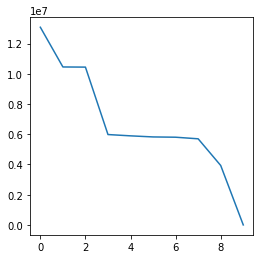

/usr/local/lib/python3.8/dist-packages/sklearn/manifold/_t_sne.py:780: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/usr/local/lib/python3.8/dist-packages/sklearn/manifold/_t_sne.py:790: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(


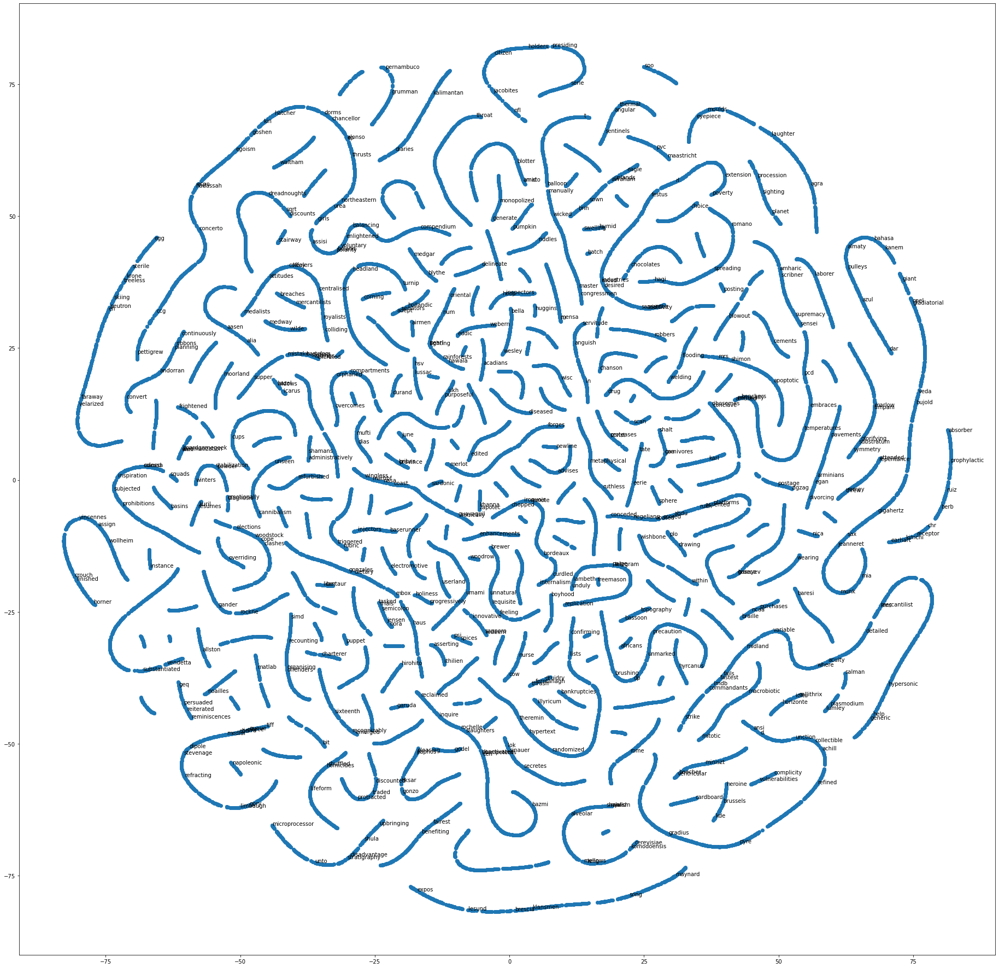

0.0 (0/506) score on analogy test.


<Figure size 432x288 with 0 Axes>

In [ ]:
model_name = "1VectorSize_10MinCount_10Epochs"
args = { "epochs": 10, "sg": 1, "min_count": 10, "vector_size": 1}
results = models.run_and_evaluate_single_model(name=model_name, args=args, overwrite=GLOBAL_OVERWRITE, plot=True, run_eval=True)

Cleaned_CBOW_100VectorSize_10Epochs.model
Loss after epoch 0: 6648903.5
Loss after epoch 1: 4545803.5
Loss after epoch 2: 4066562.0
Loss after epoch 3: 3494841.0
Loss after epoch 4: 3125988.0
Loss after epoch 5: 3081060.0
Loss after epoch 6: 3011542.0
Loss after epoch 7: 2968474.0
Loss after epoch 8: 2794126.0
Loss after epoch 9: 1681888.0
execution time: 92.12547074600002
Model training complete.  [6648903.5, 4545803.5, 4066562.0, 3494841.0, 3125988.0, 3081060.0, 3011542.0, 2968474.0, 2794126.0, 1681888.0]
[6648903.5, 4545803.5, 4066562.0, 3494841.0, 3125988.0, 3081060.0, 3011542.0, 2968474.0, 2794126.0, 1681888.0]
Cleaned_CBOW_100VectorSize_10Epochs loss vs epoch plot


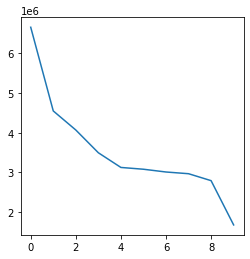

/usr/local/lib/python3.8/dist-packages/sklearn/manifold/_t_sne.py:780: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/usr/local/lib/python3.8/dist-packages/sklearn/manifold/_t_sne.py:790: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(


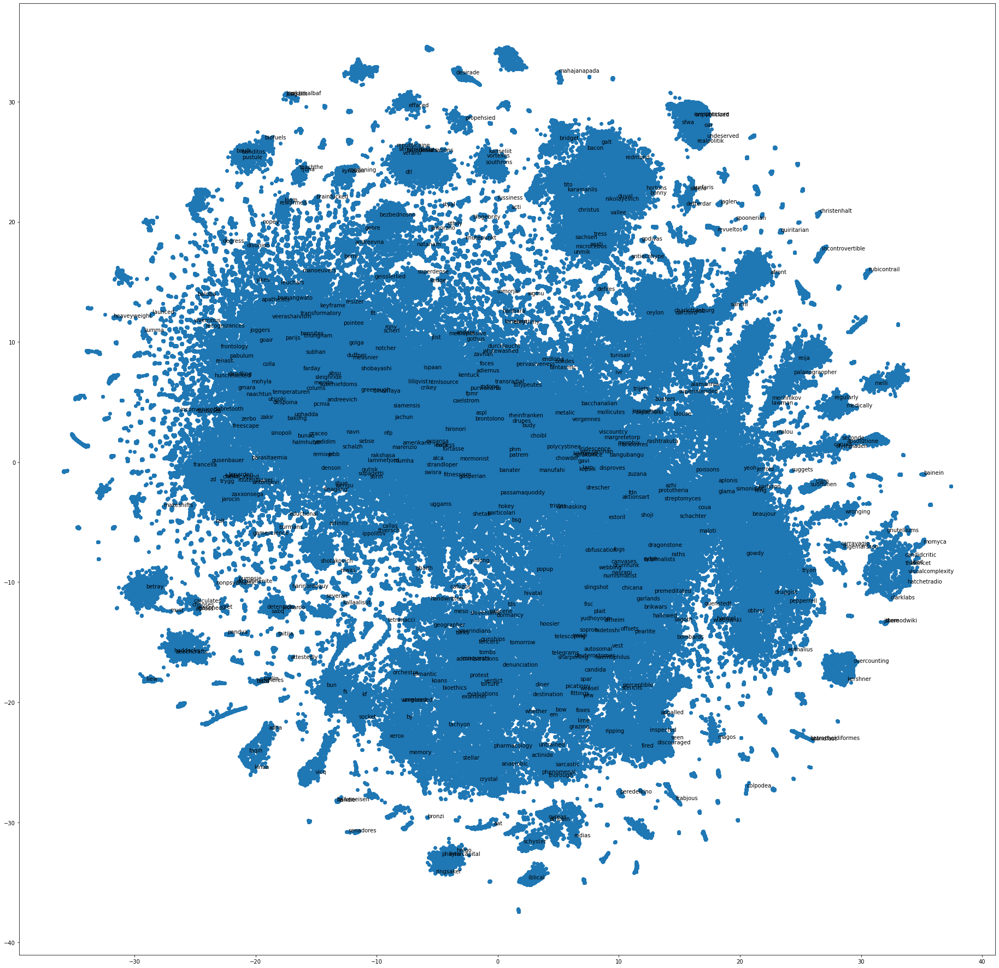

0.1794871794871795 (77/429) score on analogy test.


<Figure size 432x288 with 0 Axes>

In [7]:
model_name = "Cleaned_CBOW_100VectorSize_10Epochs"
args = { "epochs": 10, "sg": 0, "vector_size": 100}
results = models.run_and_evaluate_single_model(name=model_name, args=args, overwrite=GLOBAL_OVERWRITE, plot=True, run_eval=True)

CBOW_10Epochs.model
Loss after epoch 0: 6787861.5
Loss after epoch 1: 4597858.5
Loss after epoch 2: 4147605.0
Loss after epoch 3: 3507435.0
Loss after epoch 4: 3183164.0
Loss after epoch 5: 3110990.0
Loss after epoch 6: 3050548.0
Loss after epoch 7: 2997134.0
Loss after epoch 8: 2631588.0
Loss after epoch 9: 1689280.0
execution time: 88.17603508900038
Model training complete.  [6787861.5, 4597858.5, 4147605.0, 3507435.0, 3183164.0, 3110990.0, 3050548.0, 2997134.0, 2631588.0, 1689280.0]
[6787861.5, 4597858.5, 4147605.0, 3507435.0, 3183164.0, 3110990.0, 3050548.0, 2997134.0, 2631588.0, 1689280.0]
CBOW_10Epochs loss vs epoch plot


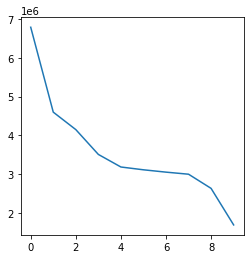

/usr/local/lib/python3.8/dist-packages/sklearn/manifold/_t_sne.py:780: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/usr/local/lib/python3.8/dist-packages/sklearn/manifold/_t_sne.py:790: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(


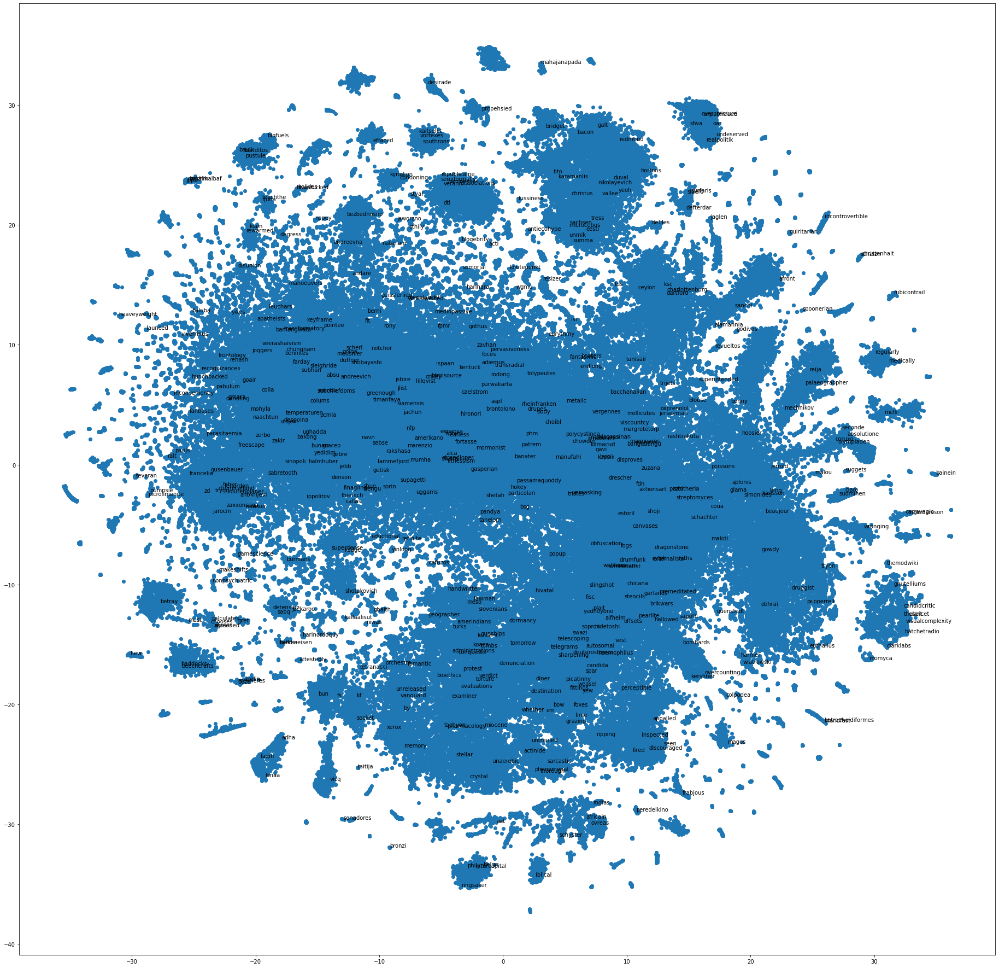

0.20190023752969122 (85/421) score on analogy test.


<Figure size 432x288 with 0 Axes>

In [ ]:
model_name = "CBOW_10Epochs"
args = { "epochs": 10, "sg": 0, "vector_size": 100}
results = models.run_and_evaluate_single_model(name=model_name, args=args, overwrite=GLOBAL_OVERWRITE, plot=True, run_eval=True)

SG_10Vector_5Negs_10WindowSize_10Epochs.model
Loss after epoch 0: 10672393.0
Loss after epoch 1: 7792905.0
Loss after epoch 2: 6498466.0
Loss after epoch 3: 6527842.0
Loss after epoch 4: 4610510.0
Loss after epoch 5: 3696672.0
Loss after epoch 6: 3687504.0
Loss after epoch 7: 3654160.0
Loss after epoch 8: 3640352.0
Loss after epoch 9: 3666816.0
execution time: 87.13227034099964
Model training complete.  [10672393.0, 7792905.0, 6498466.0, 6527842.0, 4610510.0, 3696672.0, 3687504.0, 3654160.0, 3640352.0, 3666816.0]
[10672393.0, 7792905.0, 6498466.0, 6527842.0, 4610510.0, 3696672.0, 3687504.0, 3654160.0, 3640352.0, 3666816.0]
SG_10Vector_5Negs_10WindowSize_10Epochs loss vs epoch plot


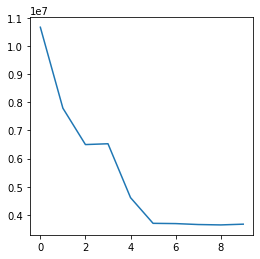

/usr/local/lib/python3.8/dist-packages/sklearn/manifold/_t_sne.py:780: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/usr/local/lib/python3.8/dist-packages/sklearn/manifold/_t_sne.py:790: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(


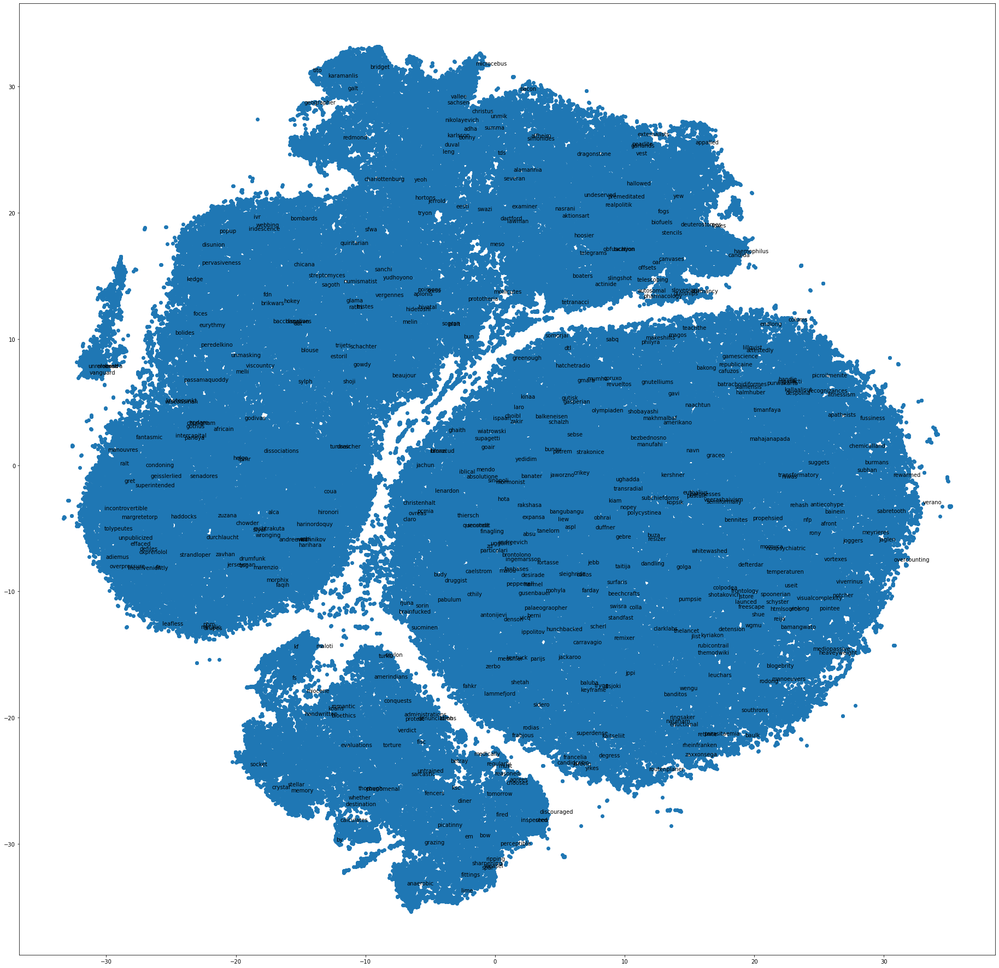

0.012 (6/500) score on analogy test.


<Figure size 432x288 with 0 Axes>

In [ ]:
model_name = "SG_10Vector_5Negs_10WindowSize_10Epochs"
args = { "epochs": 10, "sg": 1, "negative": 5, "vector_size": 10}
results = models.run_and_evaluate_single_model(name=model_name, args=args, overwrite=GLOBAL_OVERWRITE, plot=True, run_eval=True)

SG_300Vector_50Negs_10Epochs.model
Loss after epoch 0: 5223442.5
Loss after epoch 1: 4384290.5
Loss after epoch 2: 4232308.0
Loss after epoch 3: 4145701.0
Loss after epoch 4: 3966304.0
Loss after epoch 5: 3898984.0
Loss after epoch 6: 3911488.0
Loss after epoch 7: 3863110.0
Loss after epoch 8: 3710736.0
Loss after epoch 9: 3762040.0
execution time: 378.171565523
Model training complete.  [5223442.5, 4384290.5, 4232308.0, 4145701.0, 3966304.0, 3898984.0, 3911488.0, 3863110.0, 3710736.0, 3762040.0]
[5223442.5, 4384290.5, 4232308.0, 4145701.0, 3966304.0, 3898984.0, 3911488.0, 3863110.0, 3710736.0, 3762040.0]
SG_300Vector_50Negs_10Epochs loss vs epoch plot


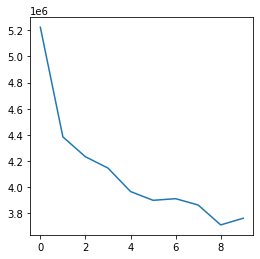

/usr/local/lib/python3.8/dist-packages/sklearn/manifold/_t_sne.py:780: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/usr/local/lib/python3.8/dist-packages/sklearn/manifold/_t_sne.py:790: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(


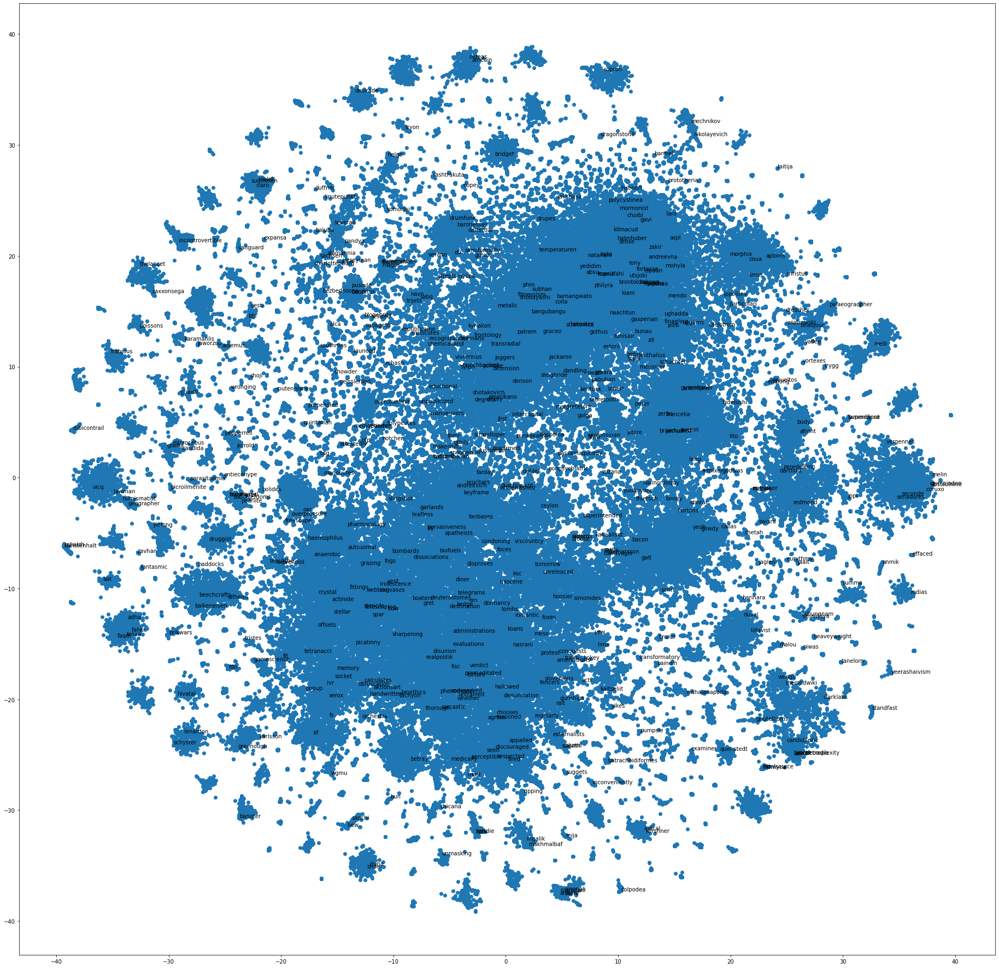

0.1632183908045977 (71/435) score on analogy test.


<Figure size 432x288 with 0 Axes>

In [ ]:
model_name = "SG_300Vector_50Negs_10Epochs"
args = { "epochs": 10, "sg": 1, "negative": 50, "vector_size": 300}
results = models.run_and_evaluate_single_model(name=model_name, args=args, overwrite=GLOBAL_OVERWRITE, plot=True, run_eval=True)

SG_300Vector_25Negs_1WindowSize_10Epochs.model
Loss after epoch 0: 5377079.5
Loss after epoch 1: 4070021.5
Loss after epoch 2: 3710598.0
Loss after epoch 3: 3669793.0
Loss after epoch 4: 3429288.0
Loss after epoch 5: 3345320.0
Loss after epoch 6: 3293530.0
Loss after epoch 7: 3219396.0
Loss after epoch 8: 3206806.0
Loss after epoch 9: 3064524.0
execution time: 210.2780218450007
Model training complete.  [5377079.5, 4070021.5, 3710598.0, 3669793.0, 3429288.0, 3345320.0, 3293530.0, 3219396.0, 3206806.0, 3064524.0]
[5377079.5, 4070021.5, 3710598.0, 3669793.0, 3429288.0, 3345320.0, 3293530.0, 3219396.0, 3206806.0, 3064524.0]
SG_300Vector_25Negs_1WindowSize_10Epochs loss vs epoch plot


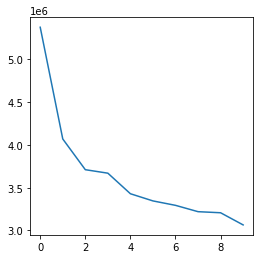

/usr/local/lib/python3.8/dist-packages/sklearn/manifold/_t_sne.py:780: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/usr/local/lib/python3.8/dist-packages/sklearn/manifold/_t_sne.py:790: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(


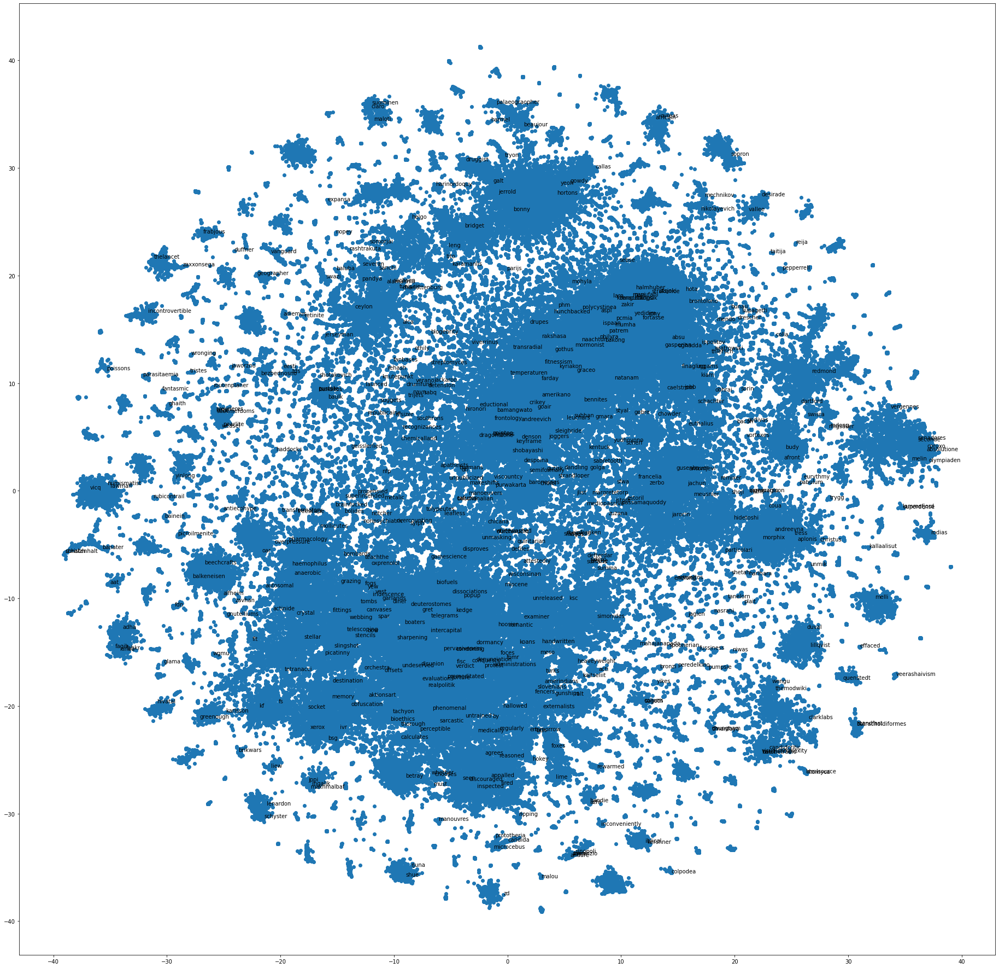

0.2222222222222222 (92/414) score on analogy test.


<Figure size 432x288 with 0 Axes>

In [ ]:
model_name = "SG_300Vector_25Negs_1WindowSize_10Epochs"
args = { "epochs": 10, "sg": 1, "negative": 25, "vector_size": 300, "window_size": 1}
results = models.run_and_evaluate_single_model(name=model_name, args=args, overwrite=GLOBAL_OVERWRITE, plot=True, run_eval=True)

SG_300Vector_25Negs_10WindowSize_10Epochs.model
Loss after epoch 0: 21678940.0
Loss after epoch 1: 19982908.0
Loss after epoch 2: 20184604.0
Loss after epoch 3: 10340100.0
Loss after epoch 4: 6661080.0
Loss after epoch 5: 6385616.0
Loss after epoch 6: 6179336.0
Loss after epoch 7: 5950760.0
Loss after epoch 8: 5737280.0
Loss after epoch 9: 5527472.0
execution time: 1099.2137333409992
Model training complete.  [21678940.0, 19982908.0, 20184604.0, 10340100.0, 6661080.0, 6385616.0, 6179336.0, 5950760.0, 5737280.0, 5527472.0]
[21678940.0, 19982908.0, 20184604.0, 10340100.0, 6661080.0, 6385616.0, 6179336.0, 5950760.0, 5737280.0, 5527472.0]
SG_300Vector_25Negs_10WindowSize_10Epochs loss vs epoch plot


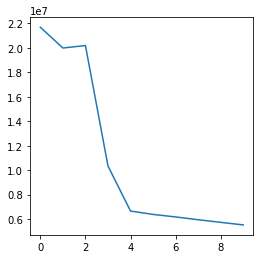

/usr/local/lib/python3.8/dist-packages/sklearn/manifold/_t_sne.py:780: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/usr/local/lib/python3.8/dist-packages/sklearn/manifold/_t_sne.py:790: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(


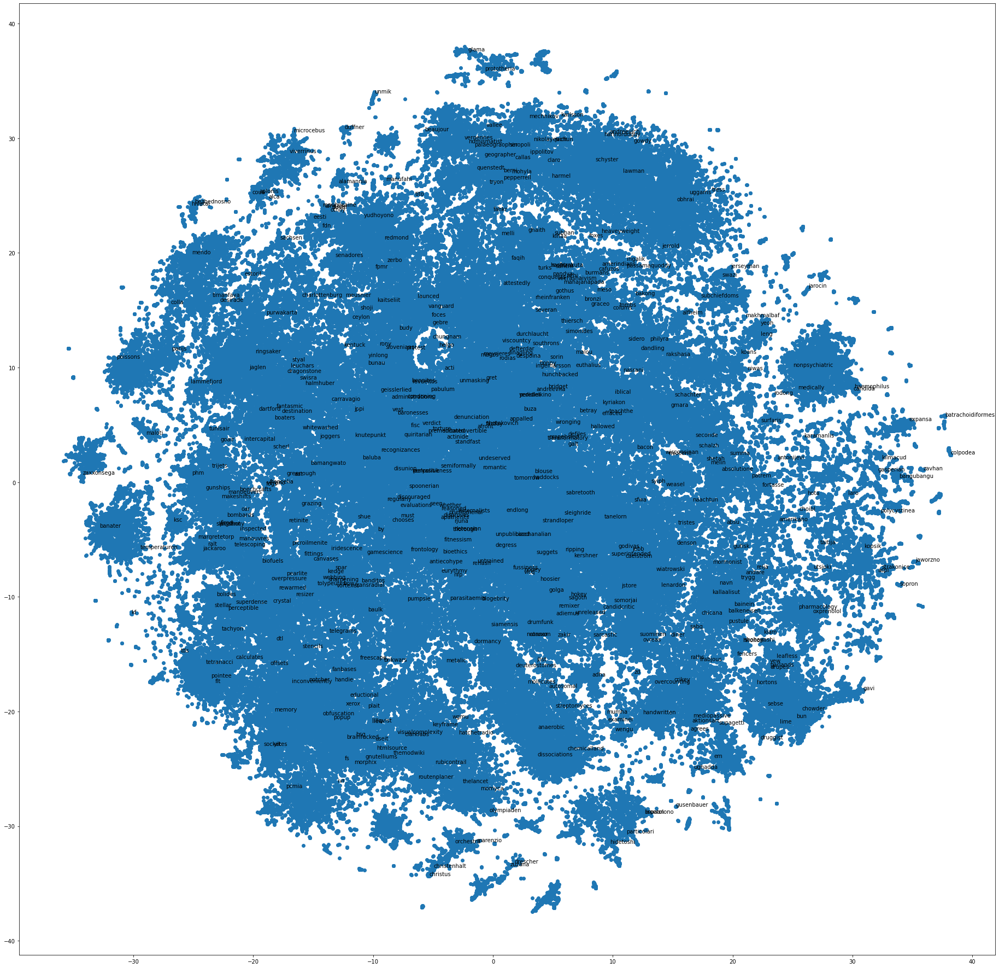

3.288135593220339 (388/118) score on analogy test.


<Figure size 432x288 with 0 Axes>

In [ ]:
model_name = "SG_300Vector_25Negs_10WindowSize_10Epochs"
args = { "epochs": 10, "sg": 1, "negative": 25, "vector_size": 300, "window_size": 10}
results = models.run_and_evaluate_single_model(name=model_name, args=args, overwrite=GLOBAL_OVERWRITE, plot=True, run_eval=True)

SG_300Vector_25Negs_25WindowSize_10Epochs.model
Loss after epoch 0: 39310544.0
Loss after epoch 1: 31273688.0
Loss after epoch 2: 15459632.0
Loss after epoch 3: 15304288.0
Loss after epoch 4: 15159520.0
Loss after epoch 5: 14665976.0
Loss after epoch 6: 3044080.0
Loss after epoch 7: 0.0
Loss after epoch 8: 0.0
Loss after epoch 9: 0.0
execution time: 2538.9174177480018
Model training complete.  [39310544.0, 31273688.0, 15459632.0, 15304288.0, 15159520.0, 14665976.0, 3044080.0, 0.0, 0.0, 0.0]
[39310544.0, 31273688.0, 15459632.0, 15304288.0, 15159520.0, 14665976.0, 3044080.0, 0.0, 0.0, 0.0]
SG_300Vector_25Negs_25WindowSize_10Epochs loss vs epoch plot


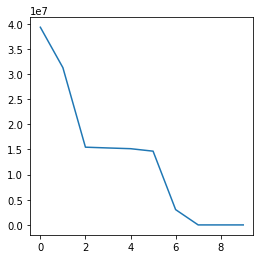

/usr/local/lib/python3.8/dist-packages/sklearn/manifold/_t_sne.py:780: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/usr/local/lib/python3.8/dist-packages/sklearn/manifold/_t_sne.py:790: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(


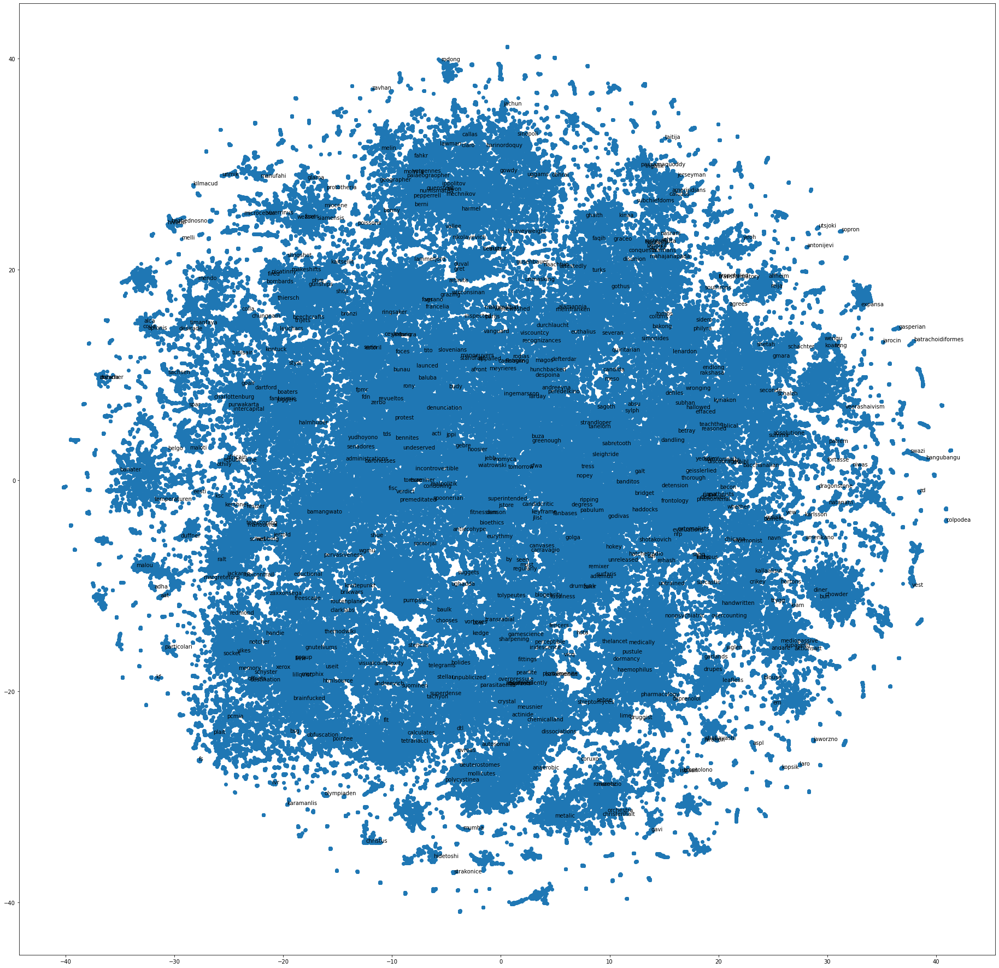

3.113821138211382 (383/123) score on analogy test.


<Figure size 432x288 with 0 Axes>

In [ ]:
model_name = "SG_300Vector_25Negs_25WindowSize_10Epochs"
args = { "epochs": 10, "sg": 1, "negative": 25, "vector_size": 300, "window_size": 25}
results = models.run_and_evaluate_single_model(name=model_name, args=args, overwrite=GLOBAL_OVERWRITE, plot=True, run_eval=True)

SG_300Vector_25Negs_25WindowSize_50Mincount_10Epochs.model
Loss after epoch 0: 42797648.0
Loss after epoch 1: 31423760.0
Loss after epoch 2: 16804336.0
Loss after epoch 3: 16578912.0
Loss after epoch 4: 16313040.0
Loss after epoch 5: 10300032.0
Loss after epoch 6: 0.0
Loss after epoch 7: 0.0
Loss after epoch 8: 0.0
Loss after epoch 9: 0.0
execution time: 2567.2220980720012
Model training complete.  [42797648.0, 31423760.0, 16804336.0, 16578912.0, 16313040.0, 10300032.0, 0.0, 0.0, 0.0, 0.0]
[42797648.0, 31423760.0, 16804336.0, 16578912.0, 16313040.0, 10300032.0, 0.0, 0.0, 0.0, 0.0]
SG_300Vector_25Negs_25WindowSize_50Mincount_10Epochs loss vs epoch plot


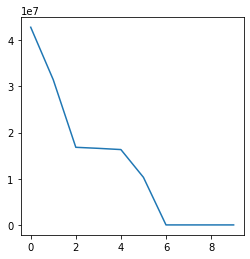

/usr/local/lib/python3.8/dist-packages/sklearn/manifold/_t_sne.py:780: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/usr/local/lib/python3.8/dist-packages/sklearn/manifold/_t_sne.py:790: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(


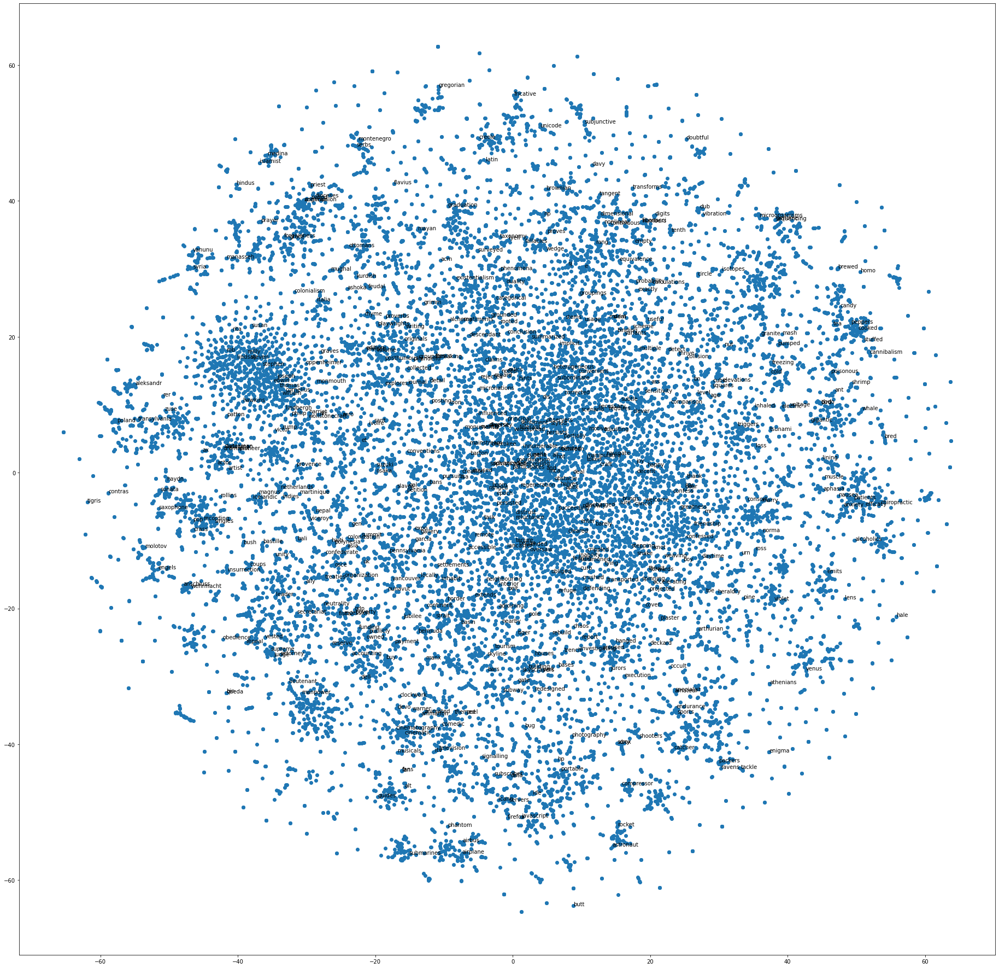

7.769230769230769 (303/39) score on analogy test.


<Figure size 432x288 with 0 Axes>

In [ ]:
model_name = "SG_300Vector_25Negs_25WindowSize_50Mincount_10Epochs"
args = { "epochs": 10, "sg": 1, "negative": 25, "min_count": 50, "vector_size": 300, "window_size": 25}
results = models.run_and_evaluate_single_model(name=model_name, args=args, overwrite=GLOBAL_OVERWRITE, plot=True, run_eval=True)

SG_300Vector_50Negs_1WindowSize_100Mincount_10Epochs.model
Loss after epoch 0: 4805689.0
Loss after epoch 1: 4235194.0
Loss after epoch 2: 4094724.0
Loss after epoch 3: 4050079.0
Loss after epoch 4: 3951862.0
Loss after epoch 5: 3954494.0
Loss after epoch 6: 3916774.0
Loss after epoch 7: 3915808.0
Loss after epoch 8: 3866752.0
Loss after epoch 9: 3835208.0
execution time: 379.8993308529971
Model training complete.  [4805689.0, 4235194.0, 4094724.0, 4050079.0, 3951862.0, 3954494.0, 3916774.0, 3915808.0, 3866752.0, 3835208.0]
[4805689.0, 4235194.0, 4094724.0, 4050079.0, 3951862.0, 3954494.0, 3916774.0, 3915808.0, 3866752.0, 3835208.0]
SG_300Vector_50Negs_1WindowSize_100Mincount_10Epochs loss vs epoch plot


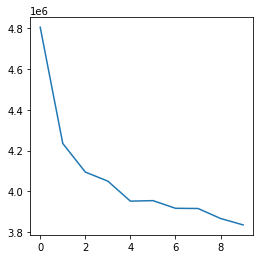

/usr/local/lib/python3.8/dist-packages/sklearn/manifold/_t_sne.py:780: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/usr/local/lib/python3.8/dist-packages/sklearn/manifold/_t_sne.py:790: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(


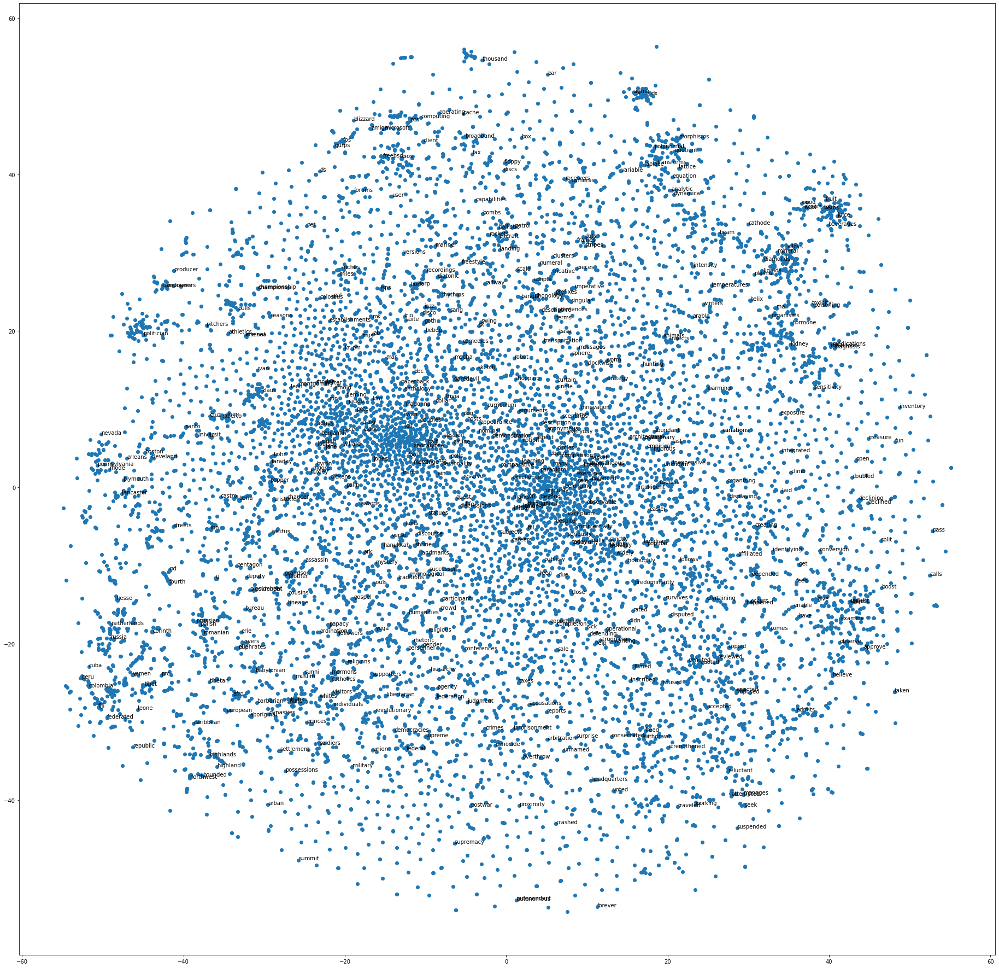

0.4634146341463415 (76/164) score on analogy test.


<Figure size 432x288 with 0 Axes>

In [ ]:
model_name = "SG_300Vector_50Negs_1WindowSize_100Mincount_10Epochs"
args = { "epochs": 10, "sg": 1, "negative": 50, "min_count": 100, "vector_size": 300, "window_size": 1}
results = models.run_and_evaluate_single_model(name=model_name, args=args, overwrite=GLOBAL_OVERWRITE, plot=True, run_eval=True)

SG_300Vector_HSM_5WindowSize_100Mincount_10Epochs.model
Loss after epoch 0: 8825067.0
Loss after epoch 1: 7089222.0
Loss after epoch 2: 6450665.0
Loss after epoch 3: 6311596.0
Loss after epoch 4: 5777942.0
Loss after epoch 5: 3884412.0
Loss after epoch 6: 3880308.0
Loss after epoch 7: 3898004.0
Loss after epoch 8: 3812756.0
Loss after epoch 9: 3785764.0
execution time: 148.30499439699997
Model training complete.  [8825067.0, 7089222.0, 6450665.0, 6311596.0, 5777942.0, 3884412.0, 3880308.0, 3898004.0, 3812756.0, 3785764.0]
[8825067.0, 7089222.0, 6450665.0, 6311596.0, 5777942.0, 3884412.0, 3880308.0, 3898004.0, 3812756.0, 3785764.0]
SG_300Vector_HSM_5WindowSize_100Mincount_10Epochs loss vs epoch plot


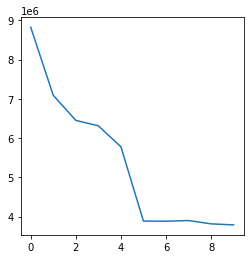

/usr/local/lib/python3.8/dist-packages/sklearn/manifold/_t_sne.py:780: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/usr/local/lib/python3.8/dist-packages/sklearn/manifold/_t_sne.py:790: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(


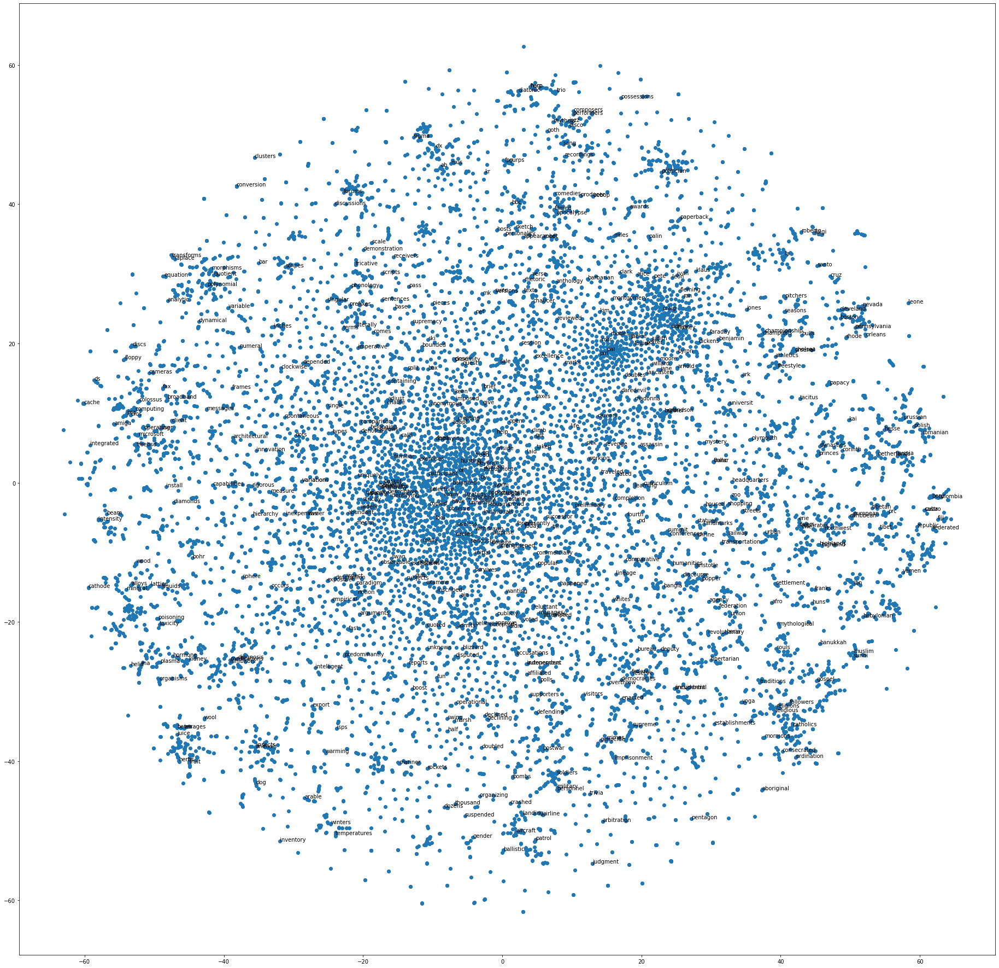

4.217391304347826 (194/46) score on analogy test.


<Figure size 432x288 with 0 Axes>

In [ ]:
model_name = "SG_300Vector_HSM_5WindowSize_100Mincount_10Epochs"
args = { "epochs": 10, "sg": 1, "hs": 1,"min_count": 100, "vector_size": 300, "window_size": 5}
results = models.run_and_evaluate_single_model(name=model_name, args=args, overwrite=GLOBAL_OVERWRITE, plot=True, run_eval=True)

CBOW_300Vector_HSM_5WindowSize_10Mincount_10Epochs.model
Loss after epoch 0: 9217990.0
Loss after epoch 1: 6651217.0
Loss after epoch 2: 5475613.0
Loss after epoch 3: 5237370.0
Loss after epoch 4: 5177318.0
Loss after epoch 5: 3716348.0
Loss after epoch 6: 2936808.0
Loss after epoch 7: 2901424.0
Loss after epoch 8: 2851444.0
Loss after epoch 9: 2839900.0
execution time: 90.56855232999806
Model training complete.  [9217990.0, 6651217.0, 5475613.0, 5237370.0, 5177318.0, 3716348.0, 2936808.0, 2901424.0, 2851444.0, 2839900.0]
[9217990.0, 6651217.0, 5475613.0, 5237370.0, 5177318.0, 3716348.0, 2936808.0, 2901424.0, 2851444.0, 2839900.0]
CBOW_300Vector_HSM_5WindowSize_10Mincount_10Epochs loss vs epoch plot


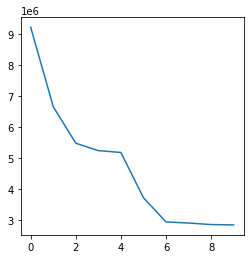

/usr/local/lib/python3.8/dist-packages/sklearn/manifold/_t_sne.py:780: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/usr/local/lib/python3.8/dist-packages/sklearn/manifold/_t_sne.py:790: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(


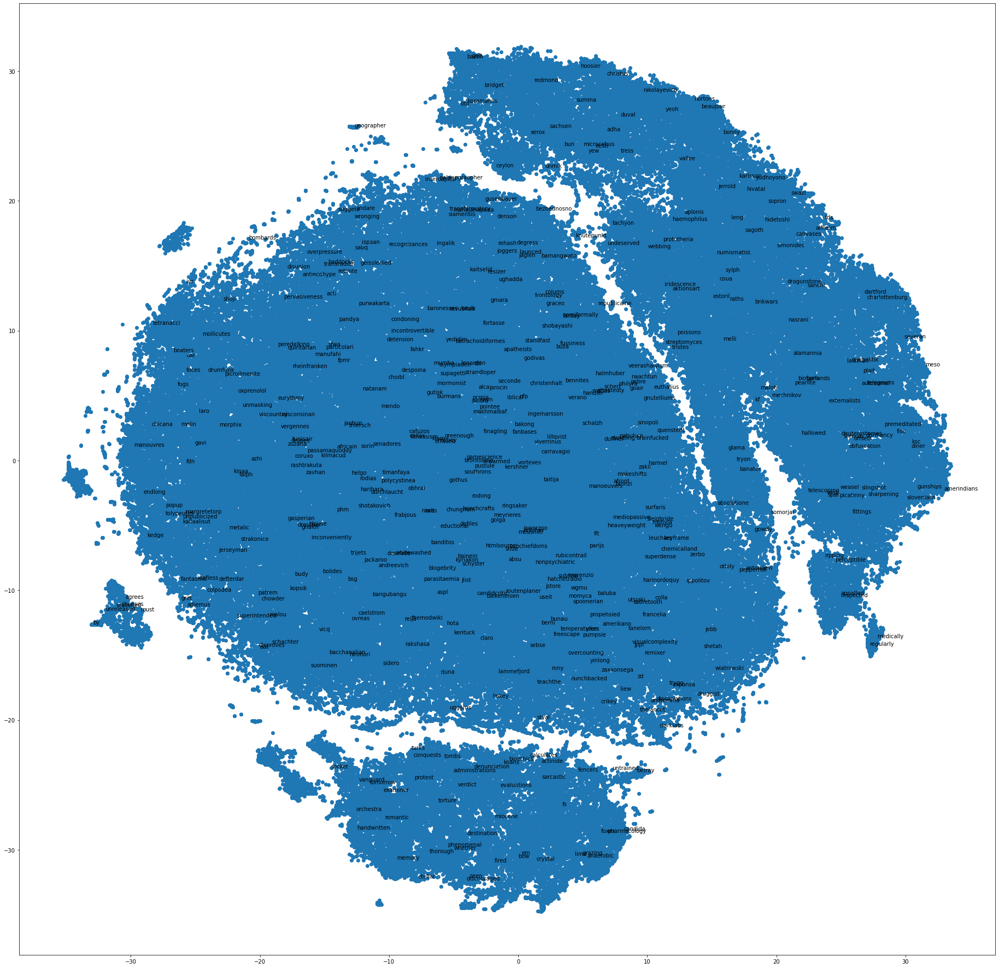

0.005964214711729622 (3/503) score on analogy test.


<Figure size 432x288 with 0 Axes>

In [ ]:
model_name = "CBOW_300Vector_HSM_5WindowSize_10Mincount_10Epochs"
args = { "epochs": 10, "sg": 0, "hs": 1,"min_count": 1, "vector_size": 10, "window_size": 1}
results = models.run_and_evaluate_single_model(name=model_name, args=args, overwrite=GLOBAL_OVERWRITE, plot=True, run_eval=True)

SG_300Vector_5Neg_1WindowSize_10Mincount_10Epochs.model
Loss after epoch 0: 10726891.0
Loss after epoch 1: 7835589.0
Loss after epoch 2: 6645940.0
Loss after epoch 3: 6766836.0
Loss after epoch 4: 4535528.0
Loss after epoch 5: 3866520.0
Loss after epoch 6: 3761220.0
Loss after epoch 7: 3784348.0
Loss after epoch 8: 3725916.0
Loss after epoch 9: 3666176.0
execution time: 92.60418301400205
Model training complete.  [10726891.0, 7835589.0, 6645940.0, 6766836.0, 4535528.0, 3866520.0, 3761220.0, 3784348.0, 3725916.0, 3666176.0]
[10726891.0, 7835589.0, 6645940.0, 6766836.0, 4535528.0, 3866520.0, 3761220.0, 3784348.0, 3725916.0, 3666176.0]
SG_300Vector_5Neg_1WindowSize_10Mincount_10Epochs loss vs epoch plot


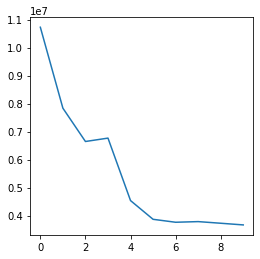

/usr/local/lib/python3.8/dist-packages/sklearn/manifold/_t_sne.py:780: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/usr/local/lib/python3.8/dist-packages/sklearn/manifold/_t_sne.py:790: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(


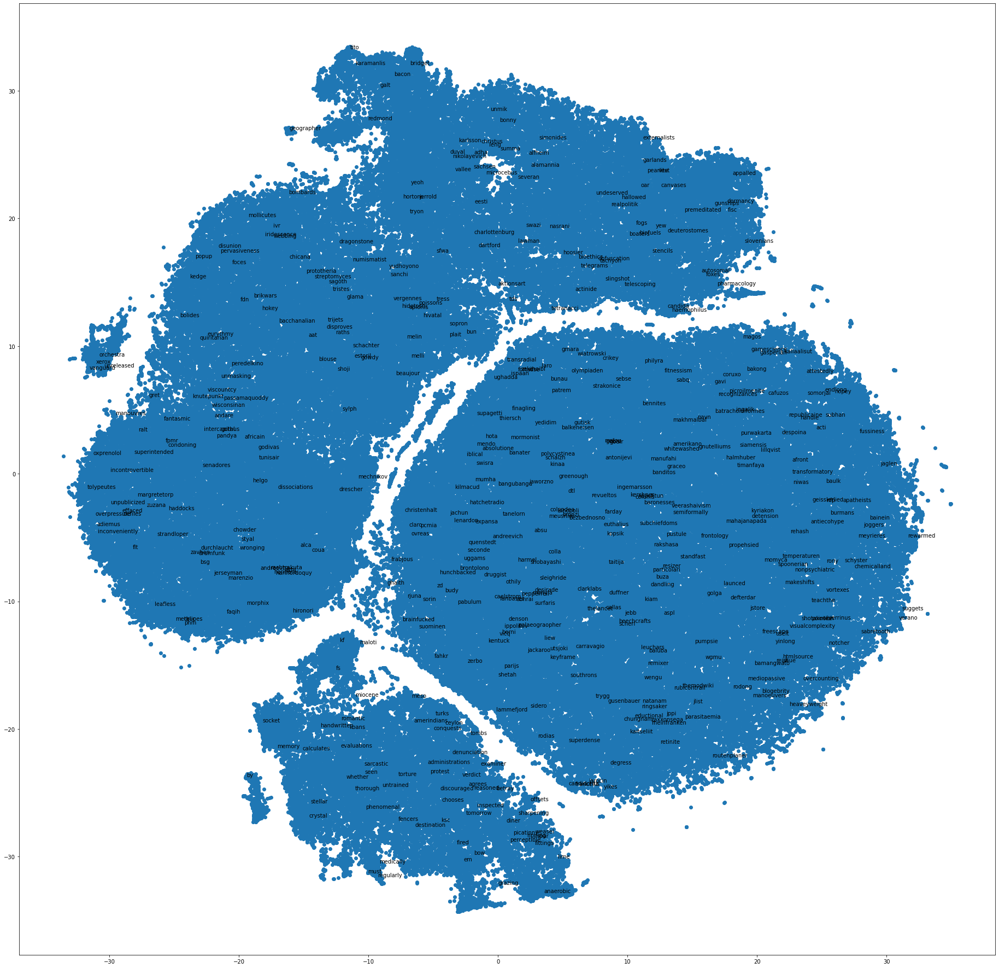

0.01606425702811245 (8/498) score on analogy test.


<Figure size 432x288 with 0 Axes>

In [ ]:
model_name = "SG_300Vector_5Neg_1WindowSize_10Mincount_10Epochs"
args = { "epochs": 10, "sg": 1, "min_count": 1, "negative": 5, "vector_size": 10, "window_size": 1}
results = models.run_and_evaluate_single_model(name=model_name, args=args, overwrite=GLOBAL_OVERWRITE, plot=True, run_eval=True)

SG_300Vector_15Neg_1WindowSize_10Mincount_10Epochs.model
Loss after epoch 0: 6309853.0
Loss after epoch 1: 4747772.0
Loss after epoch 2: 4572051.0
Loss after epoch 3: 4317326.0
Loss after epoch 4: 4275916.0
Loss after epoch 5: 4281558.0
Loss after epoch 6: 4464804.0
Loss after epoch 7: 4423296.0
Loss after epoch 8: 4312468.0
Loss after epoch 9: 4358596.0
execution time: 95.01527082999746
Model training complete.  [6309853.0, 4747772.0, 4572051.0, 4317326.0, 4275916.0, 4281558.0, 4464804.0, 4423296.0, 4312468.0, 4358596.0]
[6309853.0, 4747772.0, 4572051.0, 4317326.0, 4275916.0, 4281558.0, 4464804.0, 4423296.0, 4312468.0, 4358596.0]
SG_300Vector_15Neg_1WindowSize_10Mincount_10Epochs loss vs epoch plot


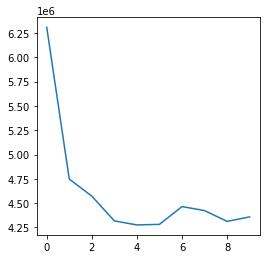

/usr/local/lib/python3.8/dist-packages/sklearn/manifold/_t_sne.py:780: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/usr/local/lib/python3.8/dist-packages/sklearn/manifold/_t_sne.py:790: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(


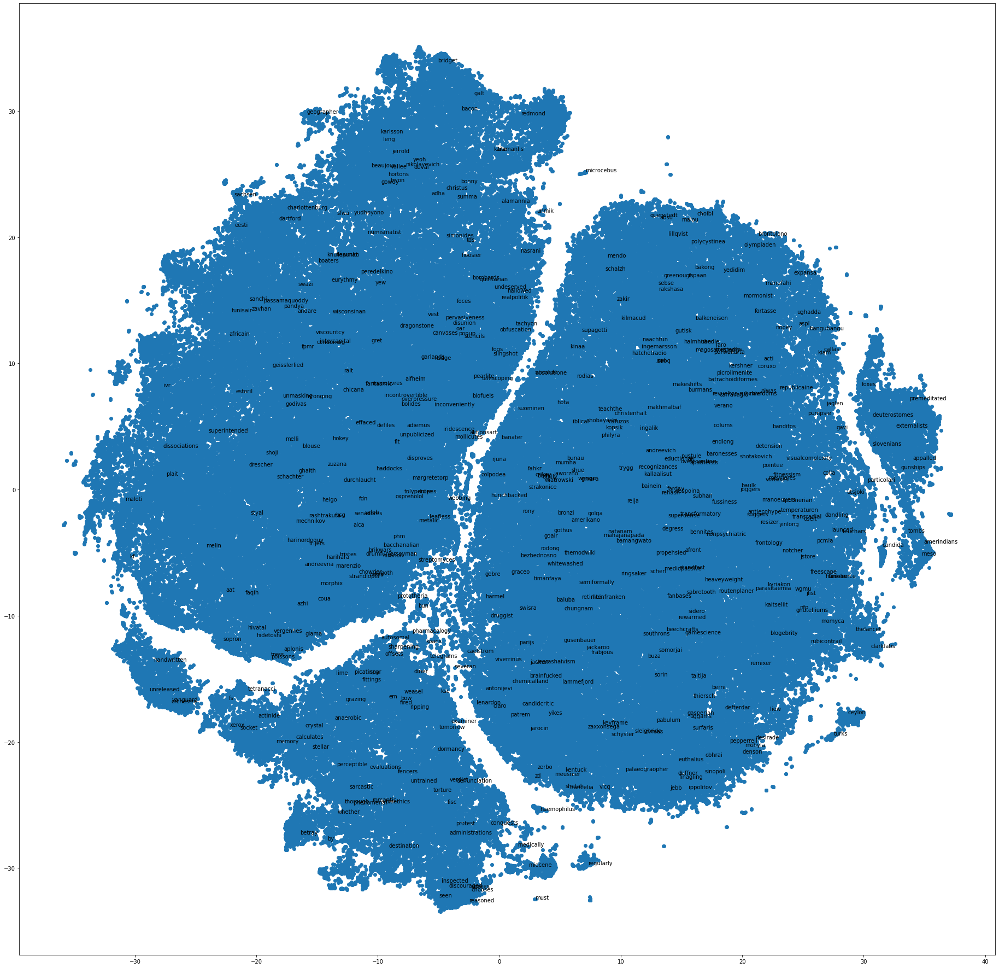

0.018108651911468814 (9/497) score on analogy test.


<Figure size 432x288 with 0 Axes>

In [ ]:
model_name = "SG_300Vector_15Neg_1WindowSize_10Mincount_10Epochs"
args = { "epochs": 10, "sg": 1, "min_count": 1, "negative": 15, "vector_size": 10, "window_size": 1}
results = models.run_and_evaluate_single_model(name=model_name, args=args, overwrite=GLOBAL_OVERWRITE, plot=True, run_eval=True)

SG_100Vector_5Neg_5WindowSize_10Mincount_10Epochs.model
Loss after epoch 0: 9389255.0
Loss after epoch 1: 7673169.0
Loss after epoch 2: 6615488.0
Loss after epoch 3: 6595170.0
Loss after epoch 4: 5283846.0
Loss after epoch 5: 3909932.0
Loss after epoch 6: 3864640.0
Loss after epoch 7: 3859912.0
Loss after epoch 8: 3752372.0
Loss after epoch 9: 3819404.0
execution time: 99.84769940000115
Model training complete.  [9389255.0, 7673169.0, 6615488.0, 6595170.0, 5283846.0, 3909932.0, 3864640.0, 3859912.0, 3752372.0, 3819404.0]
[9389255.0, 7673169.0, 6615488.0, 6595170.0, 5283846.0, 3909932.0, 3864640.0, 3859912.0, 3752372.0, 3819404.0]
SG_100Vector_5Neg_5WindowSize_10Mincount_10Epochs loss vs epoch plot


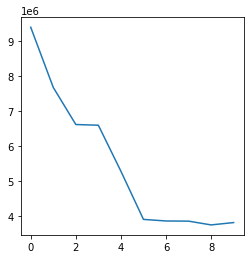

/usr/local/lib/python3.8/dist-packages/sklearn/manifold/_t_sne.py:780: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/usr/local/lib/python3.8/dist-packages/sklearn/manifold/_t_sne.py:790: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(


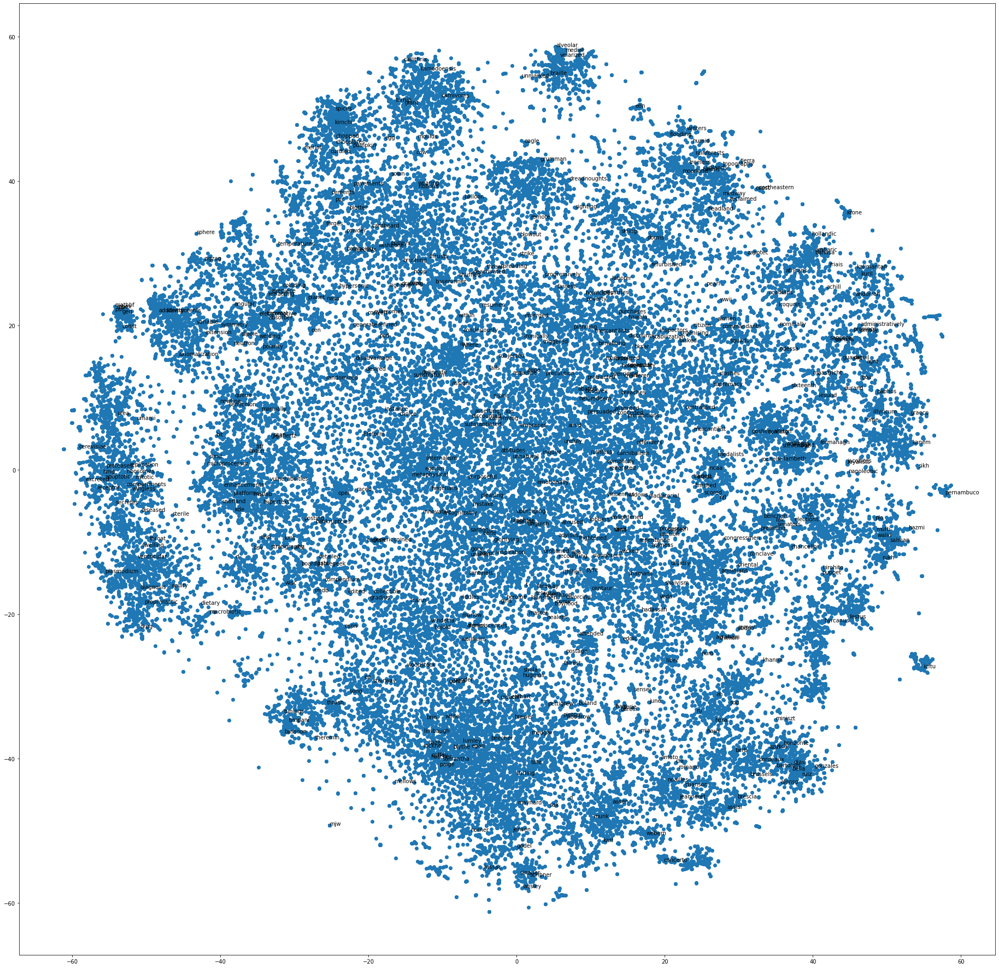

2.3289473684210527 (354/152) score on analogy test.


<Figure size 432x288 with 0 Axes>

In [ ]:
model_name= "SG_100Vector_5Neg_5WindowSize_10Mincount_10Epochs"
args = { "epochs": 10, "sg": 1, "min_count": 10, "negative": 5, "vector_size": 100, "window_size": 5}
results = models.run_and_evaluate_single_model(name=model_name, args=args, overwrite=GLOBAL_OVERWRITE, plot=True, run_eval=True)

SG_100Vector_5Neg_5WindowSize_10Mincount_10Epochs_01LearningRate.model
Loss after epoch 0: 10035909.0
Loss after epoch 1: 7627333.0
Loss after epoch 2: 6970256.0
Loss after epoch 3: 6863842.0
Loss after epoch 4: 4874668.0
Loss after epoch 5: 3952932.0
Loss after epoch 6: 3912244.0
Loss after epoch 7: 3898120.0
Loss after epoch 8: 3835584.0
Loss after epoch 9: 3931672.0
execution time: 100.42496360299992
Model training complete.  [10035909.0, 7627333.0, 6970256.0, 6863842.0, 4874668.0, 3952932.0, 3912244.0, 3898120.0, 3835584.0, 3931672.0]
[10035909.0, 7627333.0, 6970256.0, 6863842.0, 4874668.0, 3952932.0, 3912244.0, 3898120.0, 3835584.0, 3931672.0]
SG_100Vector_5Neg_5WindowSize_10Mincount_10Epochs_01LearningRate loss vs epoch plot


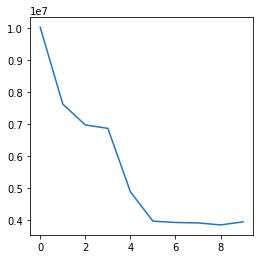

/usr/local/lib/python3.8/dist-packages/sklearn/manifold/_t_sne.py:780: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/usr/local/lib/python3.8/dist-packages/sklearn/manifold/_t_sne.py:790: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(


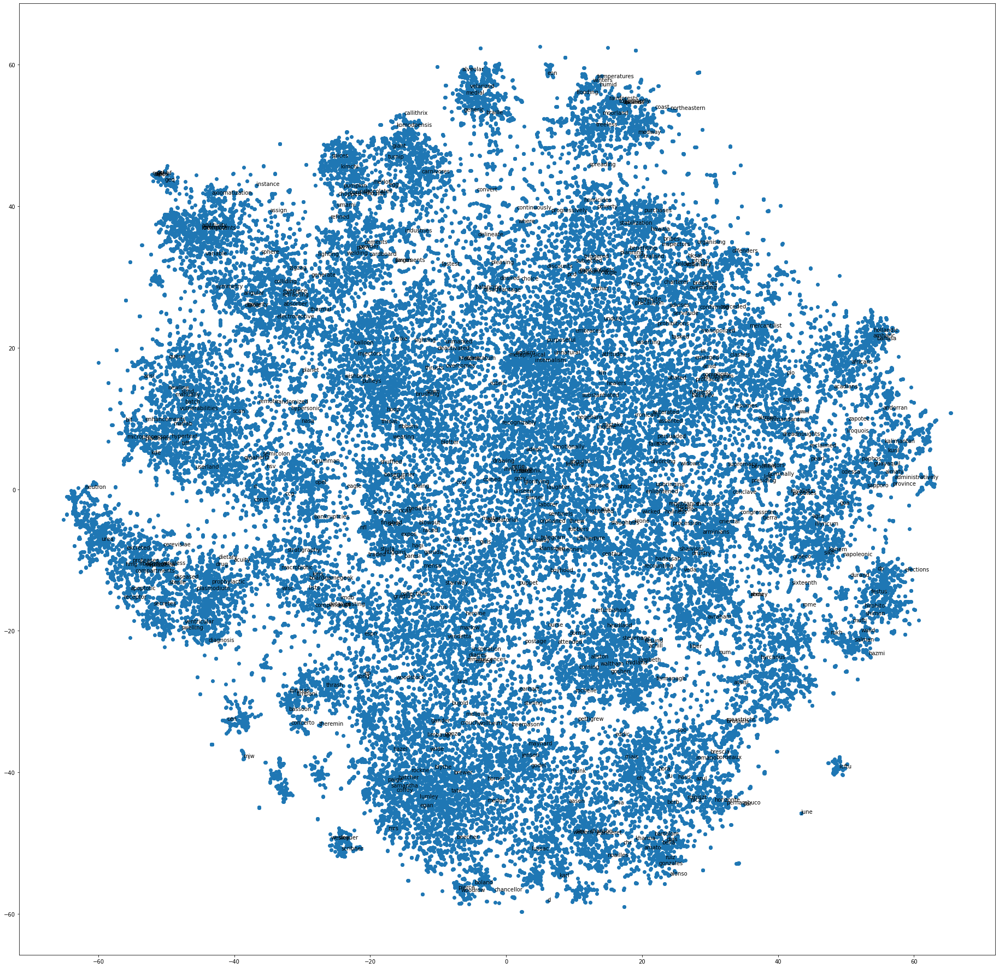

0.8602941176470589 (234/272) score on analogy test.


<Figure size 432x288 with 0 Axes>

In [ ]:
model_name = "SG_100Vector_5Neg_5WindowSize_10Mincount_10Epochs_01LearningRate"
args = { "epochs": 10, "sg": 1, "min_count": 10, "negative": 5, "vector_size": 100, "window_size": 5, "learning_rate": 0.01}
results = models.run_and_evaluate_single_model(name=model_name, args=args, overwrite=GLOBAL_OVERWRITE, plot=True, run_eval=True)

SG_100Vector_5Neg_5WindowSize_10Mincount_10Epochs_001LearningRate.model
Loss after epoch 0: 12682571.0
Loss after epoch 1: 8325499.0
Loss after epoch 2: 7789550.0
Loss after epoch 3: 6351884.0
Loss after epoch 4: 4069216.0
Loss after epoch 5: 4157740.0
Loss after epoch 6: 4162228.0
Loss after epoch 7: 4132348.0
Loss after epoch 8: 4088540.0
Loss after epoch 9: 4207680.0
execution time: 101.43486750900047
Model training complete.  [12682571.0, 8325499.0, 7789550.0, 6351884.0, 4069216.0, 4157740.0, 4162228.0, 4132348.0, 4088540.0, 4207680.0]
[12682571.0, 8325499.0, 7789550.0, 6351884.0, 4069216.0, 4157740.0, 4162228.0, 4132348.0, 4088540.0, 4207680.0]
SG_100Vector_5Neg_5WindowSize_10Mincount_10Epochs_001LearningRate loss vs epoch plot


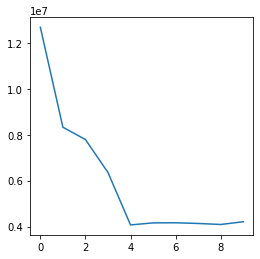

/usr/local/lib/python3.8/dist-packages/sklearn/manifold/_t_sne.py:780: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/usr/local/lib/python3.8/dist-packages/sklearn/manifold/_t_sne.py:790: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(


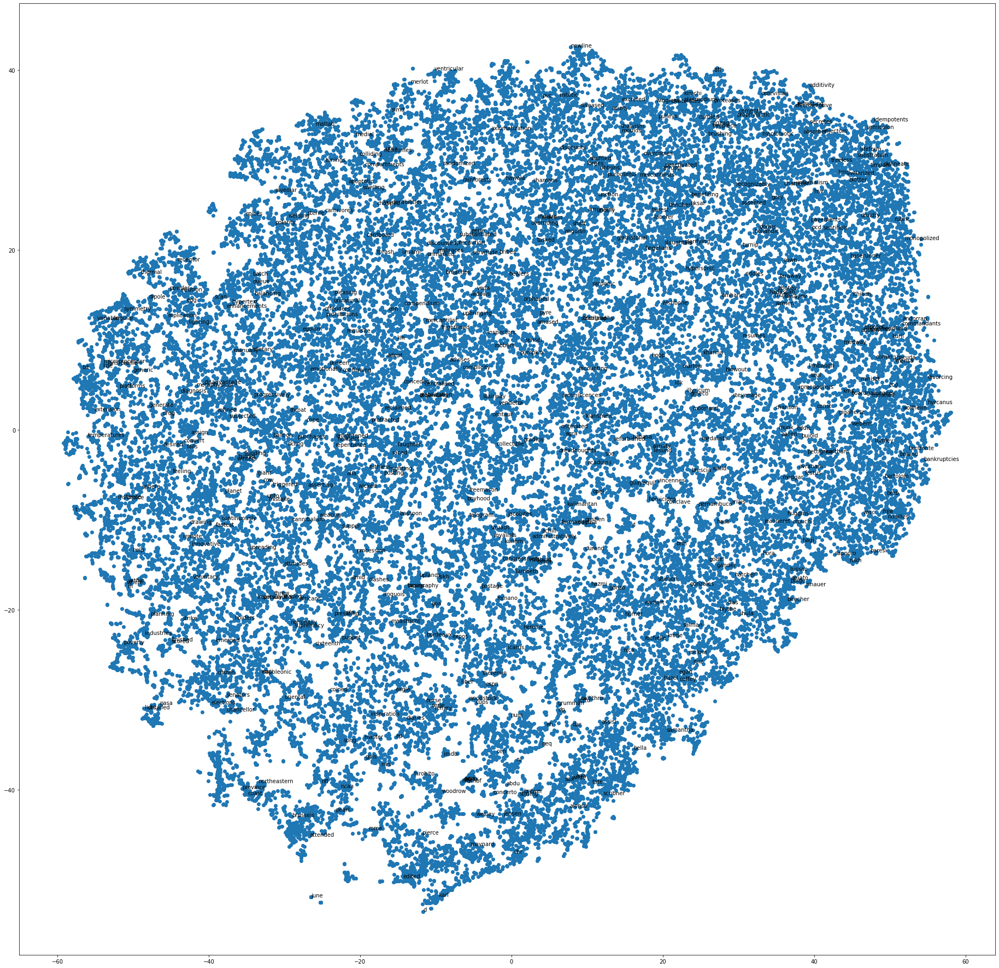

0.07203389830508475 (34/472) score on analogy test.


<Figure size 432x288 with 0 Axes>

In [ ]:
model_name = "SG_100Vector_5Neg_5WindowSize_10Mincount_10Epochs_001LearningRate"
args = { "epochs": 10, "sg": 1, "min_count": 10, "negative": 5, "vector_size": 100, "window_size": 5, "learning_rate": 0.001}
results = models.run_and_evaluate_single_model(name=model_name, args=args, overwrite=GLOBAL_OVERWRITE, plot=True, run_eval=True)

SG_100Vector_5Neg_5WindowSize_10Mincount_10Epochs_1LearningRate.model
Loss after epoch 0: 9227703.0
Loss after epoch 1: 8075809.0
Loss after epoch 2: 6763330.0
Loss after epoch 3: 6653112.0
Loss after epoch 4: 5286374.0
Loss after epoch 5: 4198240.0
Loss after epoch 6: 4079044.0
Loss after epoch 7: 4025332.0
Loss after epoch 8: 3912128.0
Loss after epoch 9: 3819992.0
execution time: 99.68345368600058
Model training complete.  [9227703.0, 8075809.0, 6763330.0, 6653112.0, 5286374.0, 4198240.0, 4079044.0, 4025332.0, 3912128.0, 3819992.0]
[9227703.0, 8075809.0, 6763330.0, 6653112.0, 5286374.0, 4198240.0, 4079044.0, 4025332.0, 3912128.0, 3819992.0]
SG_100Vector_5Neg_5WindowSize_10Mincount_10Epochs_1LearningRate loss vs epoch plot


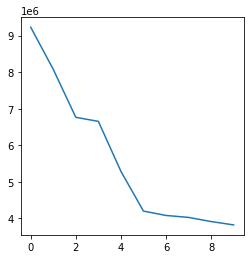

/usr/local/lib/python3.8/dist-packages/sklearn/manifold/_t_sne.py:780: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/usr/local/lib/python3.8/dist-packages/sklearn/manifold/_t_sne.py:790: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(


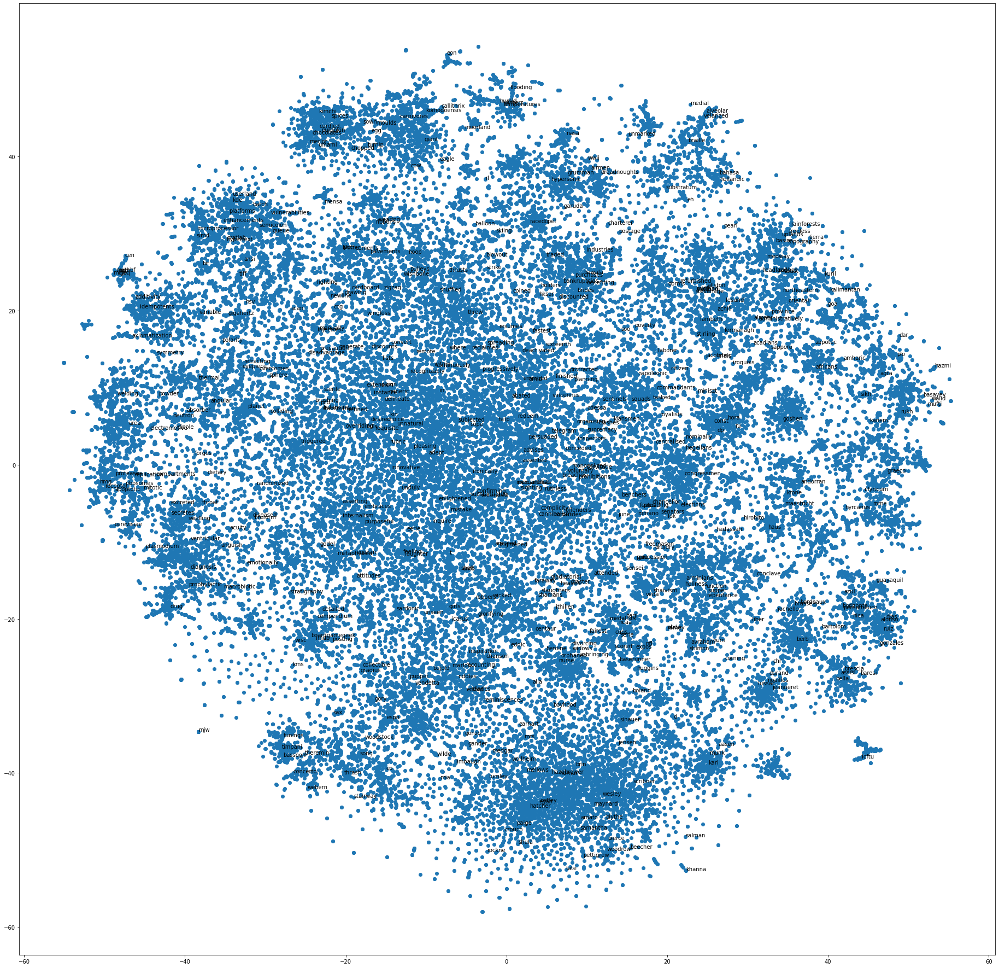

2.142857142857143 (345/161) score on analogy test.


<Figure size 432x288 with 0 Axes>

In [ ]:
model_name = "SG_100Vector_5Neg_5WindowSize_10Mincount_10Epochs_1LearningRate"
args = { "epochs": 10, "sg": 1, "min_count": 10, "negative": 5, "vector_size": 100, "window_size": 5, "learning_rate": 0.1}
results = models.run_and_evaluate_single_model(name=model_name, args=args, overwrite=GLOBAL_OVERWRITE, plot=True, run_eval=True)

SG_100Vector_5Neg_5WindowSize_10Mincount_10Epochs_5LearningRate.model
Loss after epoch 0: 88344.40625
Loss after epoch 1: 3352.75
Loss after epoch 2: 1361.8125
Loss after epoch 3: 777.9375
Loss after epoch 4: 544.7578125
Loss after epoch 5: 567.8203125
Loss after epoch 6: 360.6328125
Loss after epoch 7: 341.953125
Loss after epoch 8: 265.7265625
Loss after epoch 9: 263.1328125
execution time: 102.6518008890016
Model training complete.  [88344.40625, 3352.75, 1361.8125, 777.9375, 544.7578125, 567.8203125, 360.6328125, 341.953125, 265.7265625, 263.1328125]
[88344.40625, 3352.75, 1361.8125, 777.9375, 544.7578125, 567.8203125, 360.6328125, 341.953125, 265.7265625, 263.1328125]
SG_100Vector_5Neg_5WindowSize_10Mincount_10Epochs_5LearningRate loss vs epoch plot


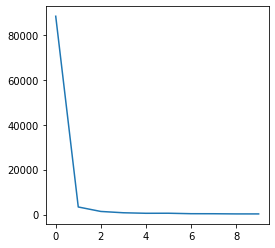

/usr/local/lib/python3.8/dist-packages/sklearn/manifold/_t_sne.py:780: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/usr/local/lib/python3.8/dist-packages/sklearn/manifold/_t_sne.py:790: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(


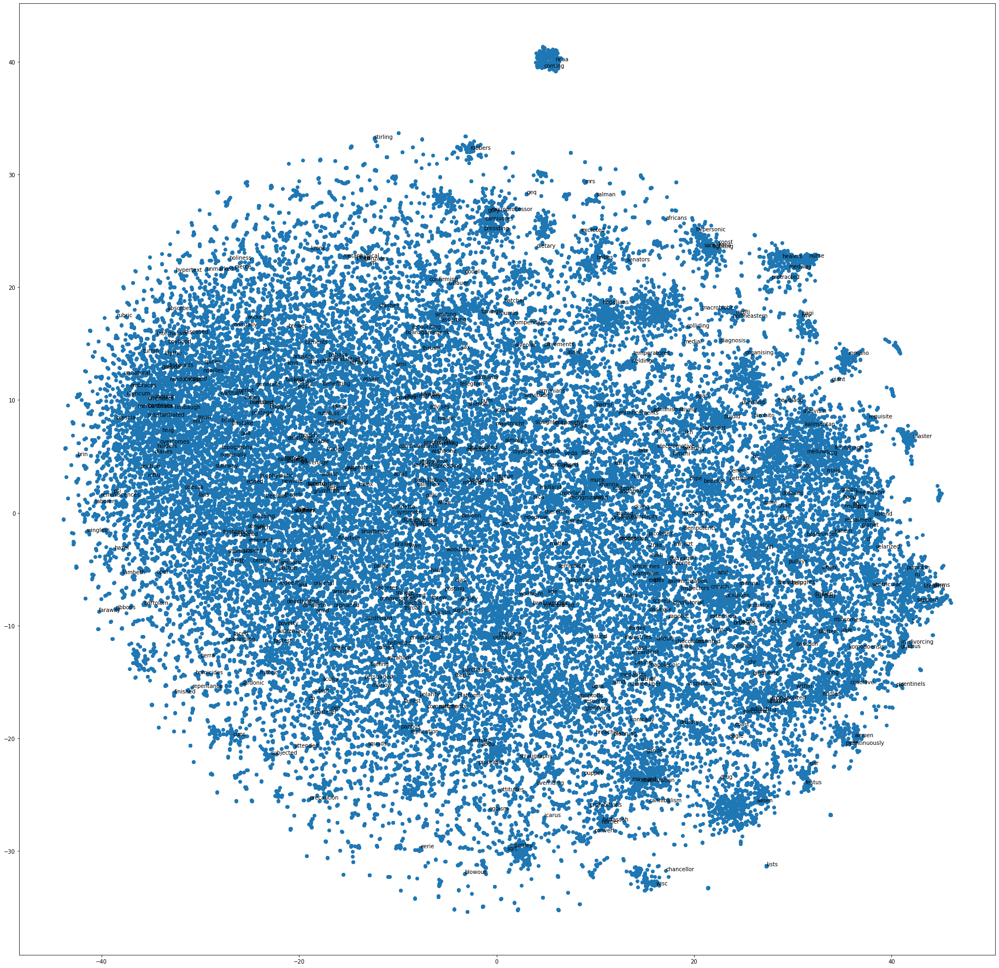

0.0 (0/506) score on analogy test.


<Figure size 432x288 with 0 Axes>

In [ ]:
model_name = "SG_100Vector_5Neg_5WindowSize_10Mincount_10Epochs_5LearningRate"
args = { "epochs": 10, "sg": 1, "min_count": 10, "negative": 5, "vector_size": 100, "window_size": 5, "learning_rate": 0.5}
results = models.run_and_evaluate_single_model(name=model_name, args=args, overwrite=GLOBAL_OVERWRITE, plot=True, run_eval=True)

SG_100Vector_5Neg_5WindowSize_10Mincount_10Epochs_Whole1LearningRate.model
Loss after epoch 0: 45106.4921875
Loss after epoch 1: 4692.94140625
Loss after epoch 2: 2877.2265625
Loss after epoch 3: 2214.66796875
Loss after epoch 4: 1618.96875
Loss after epoch 5: 1457.75390625
Loss after epoch 6: 1223.03125
Loss after epoch 7: 1062.01953125
Loss after epoch 8: 989.90625
Loss after epoch 9: 908.1171875
execution time: 102.37347910499739
Model training complete.  [45106.4921875, 4692.94140625, 2877.2265625, 2214.66796875, 1618.96875, 1457.75390625, 1223.03125, 1062.01953125, 989.90625, 908.1171875]
[45106.4921875, 4692.94140625, 2877.2265625, 2214.66796875, 1618.96875, 1457.75390625, 1223.03125, 1062.01953125, 989.90625, 908.1171875]
SG_100Vector_5Neg_5WindowSize_10Mincount_10Epochs_Whole1LearningRate loss vs epoch plot


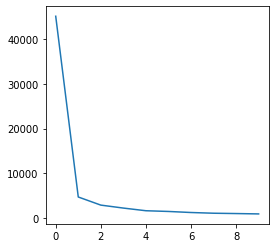

/usr/local/lib/python3.8/dist-packages/sklearn/manifold/_t_sne.py:780: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/usr/local/lib/python3.8/dist-packages/sklearn/manifold/_t_sne.py:790: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(


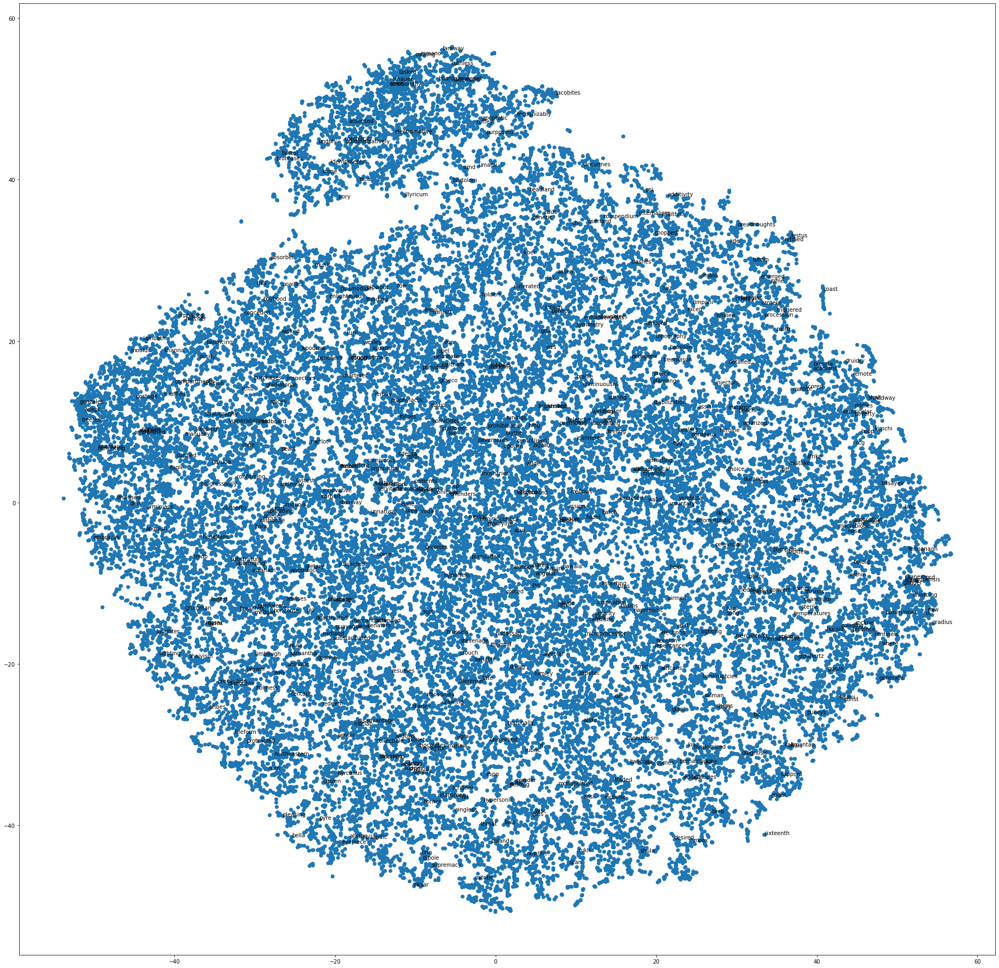

0.0 (0/506) score on analogy test.


<Figure size 432x288 with 0 Axes>

In [ ]:
model_name = "SG_100Vector_5Neg_5WindowSize_10Mincount_10Epochs_Whole1LearningRate"
args = { "epochs": 10, "sg": 1, "min_count": 10, "negative": 5, "vector_size": 100, "window_size": 5, "learning_rate": 1}
results = models.run_and_evaluate_single_model(name=model_name, args=args, overwrite=GLOBAL_OVERWRITE, plot=True, run_eval=True)

SG_100Vector_5Neg_5WindowSize_10Mincount_10Epochs_00001LearningRate.model
Loss after epoch 0: 17210254.0
Loss after epoch 1: 4106216.0
Loss after epoch 2: 6233616.0
Loss after epoch 3: 6261974.0
Loss after epoch 4: 2629148.0
Loss after epoch 5: 2758224.0
Loss after epoch 6: 2928784.0
Loss after epoch 7: 2939464.0
Loss after epoch 8: 3046292.0
Loss after epoch 9: 3122608.0
execution time: 102.4414701099995
Model training complete.  [17210254.0, 4106216.0, 6233616.0, 6261974.0, 2629148.0, 2758224.0, 2928784.0, 2939464.0, 3046292.0, 3122608.0]
[17210254.0, 4106216.0, 6233616.0, 6261974.0, 2629148.0, 2758224.0, 2928784.0, 2939464.0, 3046292.0, 3122608.0]
SG_100Vector_5Neg_5WindowSize_10Mincount_10Epochs_00001LearningRate loss vs epoch plot


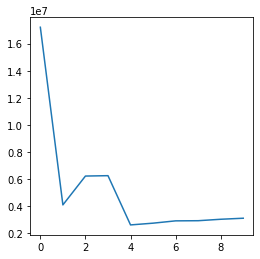

/usr/local/lib/python3.8/dist-packages/sklearn/manifold/_t_sne.py:780: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/usr/local/lib/python3.8/dist-packages/sklearn/manifold/_t_sne.py:790: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(


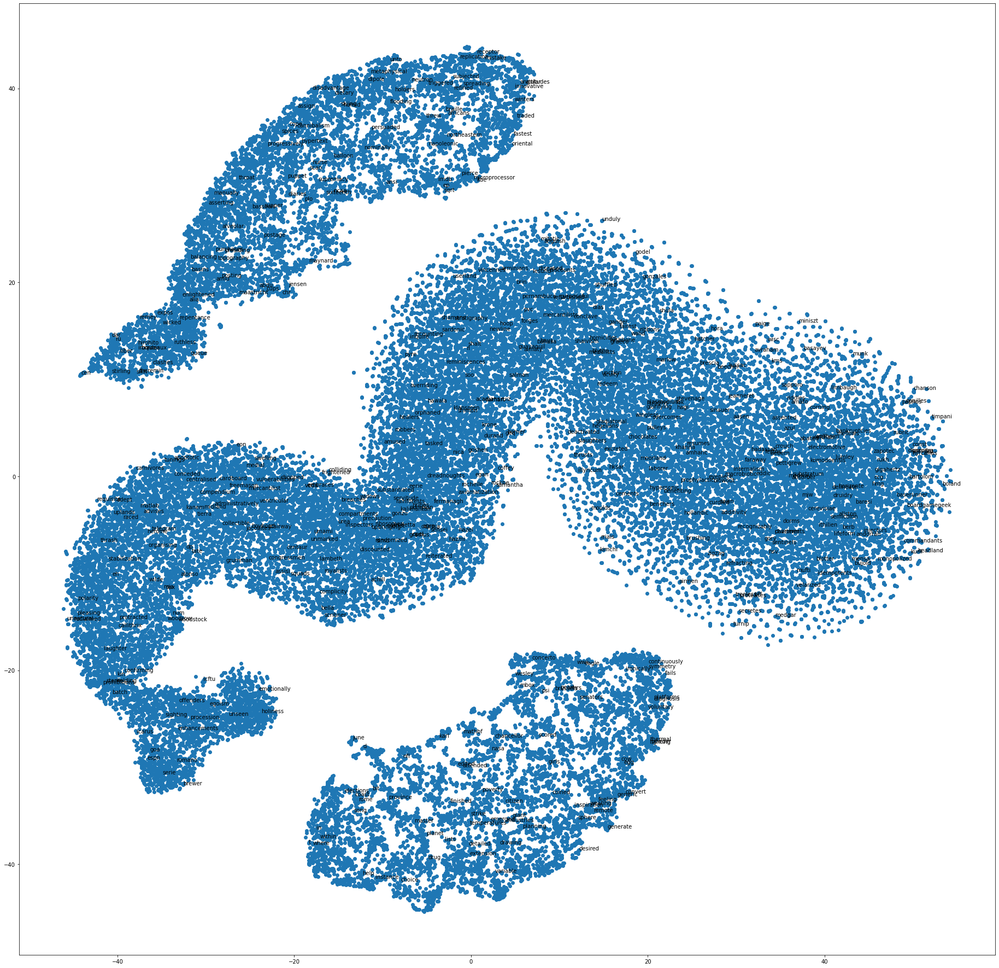

0.02636916835699797 (13/493) score on analogy test.


<Figure size 432x288 with 0 Axes>

In [ ]:
model_name = "SG_100Vector_5Neg_5WindowSize_10Mincount_10Epochs_00001LearningRate"
args = { "epochs": 10, "sg": 1, "min_count": 10, "negative": 5, "vector_size": 100, "window_size": 5, "learning_rate": .00001}
results = models.run_and_evaluate_single_model(name=model_name, args=args, overwrite=GLOBAL_OVERWRITE, plot=True, run_eval=True)

SG_100Vector_5Neg_5WindowSize_10Mincount_10Epochs_03LearningRate.model
Loss after epoch 0: 9360348.0
Loss after epoch 1: 7621580.0
Loss after epoch 2: 6732976.0
Loss after epoch 3: 6495694.0
Loss after epoch 4: 5227478.0
Loss after epoch 5: 3881364.0
Loss after epoch 6: 3825512.0
Loss after epoch 7: 3842164.0
Loss after epoch 8: 3771028.0
Loss after epoch 9: 3724844.0
execution time: 100.09768487499969
Model training complete.  [9360348.0, 7621580.0, 6732976.0, 6495694.0, 5227478.0, 3881364.0, 3825512.0, 3842164.0, 3771028.0, 3724844.0]
[9360348.0, 7621580.0, 6732976.0, 6495694.0, 5227478.0, 3881364.0, 3825512.0, 3842164.0, 3771028.0, 3724844.0]
SG_100Vector_5Neg_5WindowSize_10Mincount_10Epochs_03LearningRate loss vs epoch plot


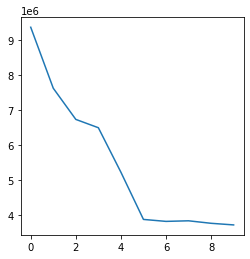

/usr/local/lib/python3.8/dist-packages/sklearn/manifold/_t_sne.py:780: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/usr/local/lib/python3.8/dist-packages/sklearn/manifold/_t_sne.py:790: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(


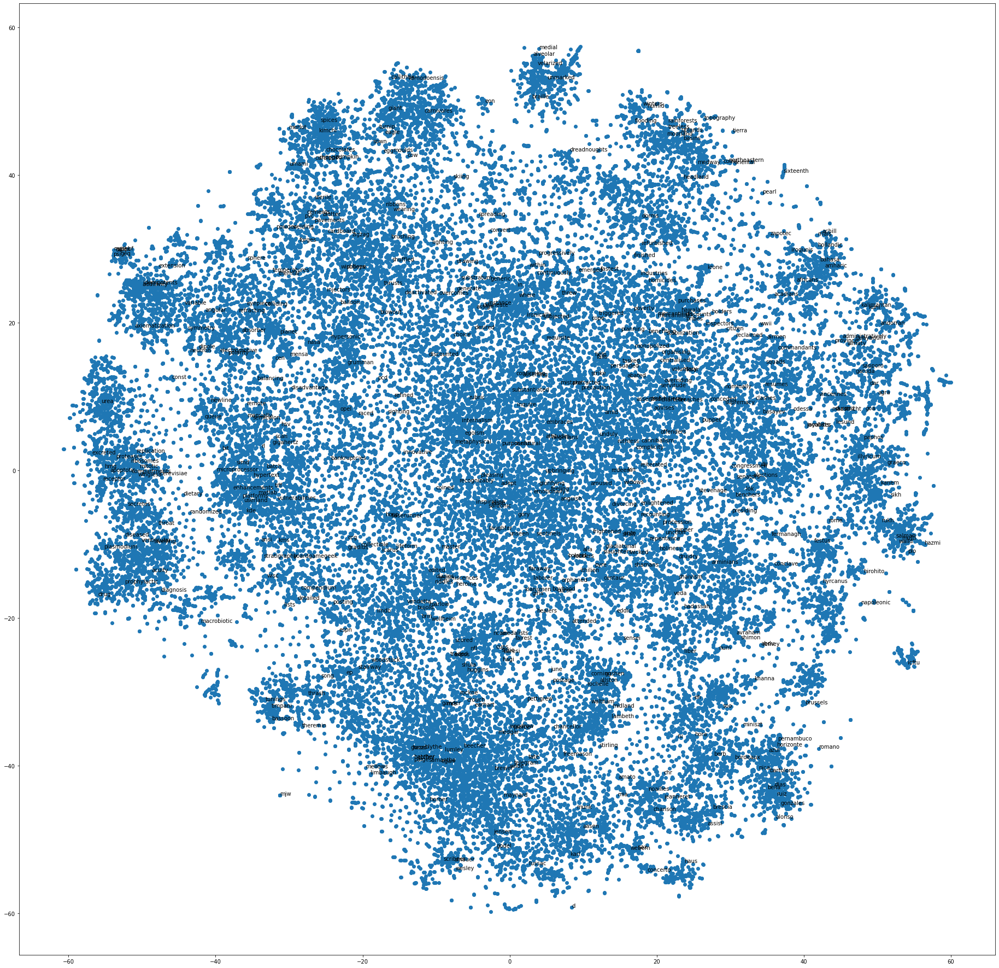

2.418918918918919 (358/148) score on analogy test.


<Figure size 432x288 with 0 Axes>

In [ ]:
model_name = "SG_100Vector_5Neg_5WindowSize_10Mincount_10Epochs_03LearningRate"
args = { "epochs": 10, "sg": 1, "min_count": 10, "negative": 5, "vector_size": 100, "window_size": 5, "learning_rate": 0.03}
results = models.run_and_evaluate_single_model(name=model_name, args=args, overwrite=GLOBAL_OVERWRITE, plot=True, run_eval=True)

SG_300Vector_5Neg_5WindowSize_10Mincount_10Epochs_03LearningRate.model
Loss after epoch 0: 9316705.0
Loss after epoch 1: 7600755.0
Loss after epoch 2: 6556842.0
Loss after epoch 3: 6518560.0
Loss after epoch 4: 5369146.0
Loss after epoch 5: 3931772.0
Loss after epoch 6: 3863932.0
Loss after epoch 7: 3900980.0
Loss after epoch 8: 3697892.0
Loss after epoch 9: 3941984.0
execution time: 99.11450861400226
Model training complete.  [9316705.0, 7600755.0, 6556842.0, 6518560.0, 5369146.0, 3931772.0, 3863932.0, 3900980.0, 3697892.0, 3941984.0]
[9316705.0, 7600755.0, 6556842.0, 6518560.0, 5369146.0, 3931772.0, 3863932.0, 3900980.0, 3697892.0, 3941984.0]
SG_300Vector_5Neg_5WindowSize_10Mincount_10Epochs_03LearningRate loss vs epoch plot


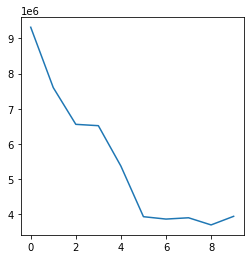

/usr/local/lib/python3.8/dist-packages/sklearn/manifold/_t_sne.py:780: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/usr/local/lib/python3.8/dist-packages/sklearn/manifold/_t_sne.py:790: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(


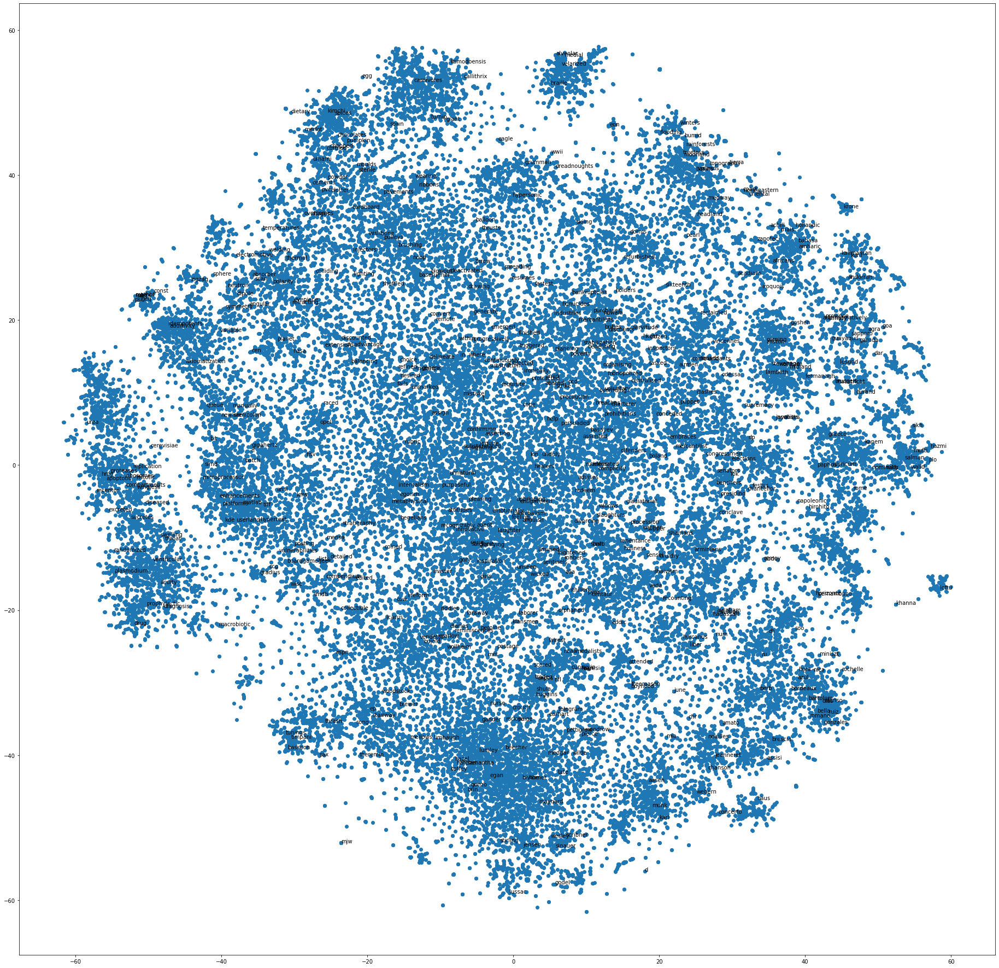

2.3959731543624163 (357/149) score on analogy test.


<Figure size 432x288 with 0 Axes>

In [ ]:
model_name = "SG_300Vector_5Neg_5WindowSize_10Mincount_10Epochs_03LearningRate"
args = { "epochs": 10, "sg": 1, "min_count": 10, "negative": 5, "vector_size": 100, "window_size": 5, "learning_rate": 0.03}
results = models.run_and_evaluate_single_model(name=model_name, args=args, overwrite=GLOBAL_OVERWRITE, plot=True, run_eval=True)

SG_300Vector_5Neg_10WindowSize_10Mincount_10Epochs_03LearningRate.model
Loss after epoch 0: 15411537.0
Loss after epoch 1: 11946941.0
Loss after epoch 2: 9614974.0
Loss after epoch 3: 7193456.0
Loss after epoch 4: 6962692.0
Loss after epoch 5: 6868876.0
Loss after epoch 6: 6856972.0
Loss after epoch 7: 2493024.0
Loss after epoch 8: 335032.0
Loss after epoch 9: 303584.0
execution time: 270.3382736379972
Model training complete.  [15411537.0, 11946941.0, 9614974.0, 7193456.0, 6962692.0, 6868876.0, 6856972.0, 2493024.0, 335032.0, 303584.0]
[15411537.0, 11946941.0, 9614974.0, 7193456.0, 6962692.0, 6868876.0, 6856972.0, 2493024.0, 335032.0, 303584.0]
SG_300Vector_5Neg_10WindowSize_10Mincount_10Epochs_03LearningRate loss vs epoch plot


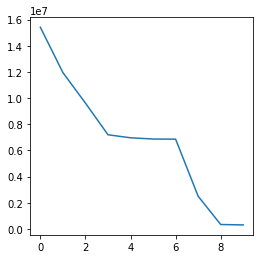

/usr/local/lib/python3.8/dist-packages/sklearn/manifold/_t_sne.py:780: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/usr/local/lib/python3.8/dist-packages/sklearn/manifold/_t_sne.py:790: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(


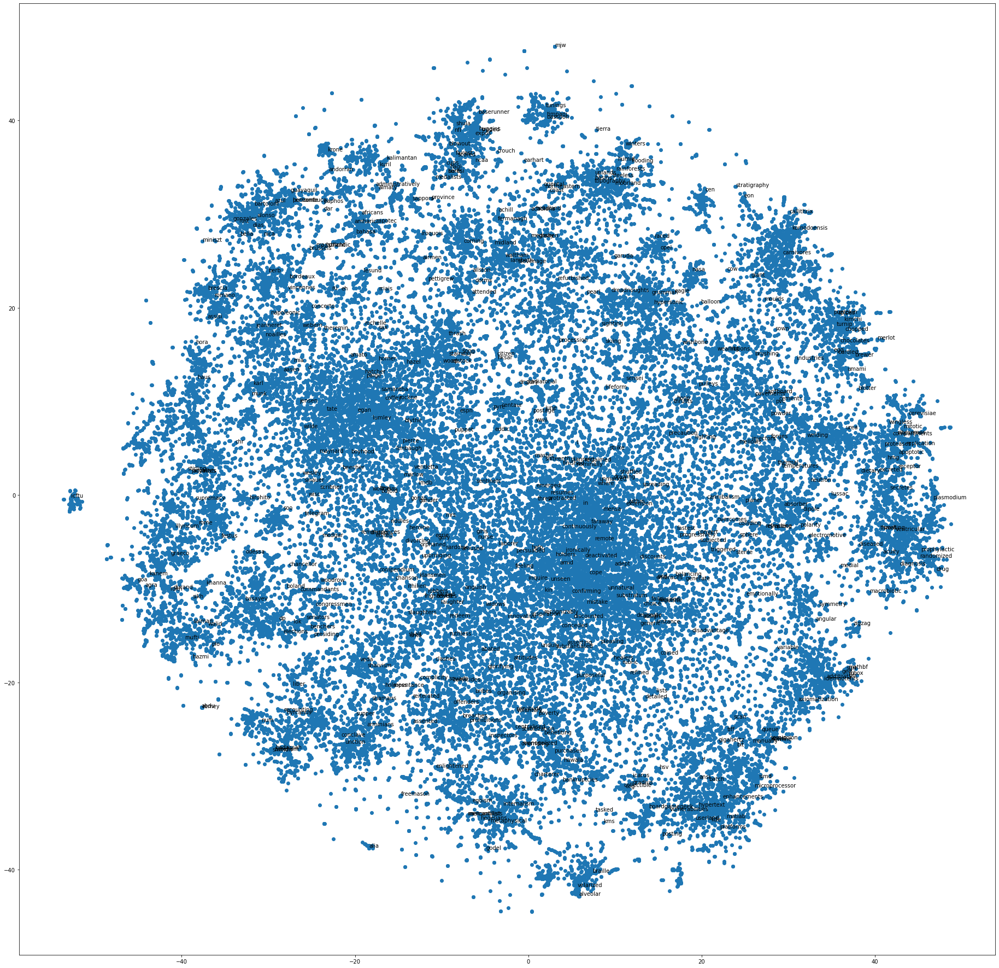

4.216494845360825 (409/97) score on analogy test.


<Figure size 432x288 with 0 Axes>

In [ ]:
model_name = "SG_300Vector_5Neg_10WindowSize_10Mincount_10Epochs_03LearningRate"
args = { "epochs": 10, "sg": 1, "min_count": 10, "negative": 5, "vector_size": 300, "window_size": 10, "learning_rate": 0.03}
results = models.run_and_evaluate_single_model(name=model_name, args=args, overwrite=GLOBAL_OVERWRITE, plot=True, run_eval=True)

SG_300Vector_5Neg_10WindowSize_10Mincount_10Epochs_025LearningRate.model
Loss after epoch 0: 15367239.0
Loss after epoch 1: 11980881.0
Loss after epoch 2: 9527920.0
Loss after epoch 3: 7053100.0
Loss after epoch 4: 7052636.0
Loss after epoch 5: 6789080.0
Loss after epoch 6: 6873032.0
Loss after epoch 7: 2684064.0
Loss after epoch 8: 315336.0
Loss after epoch 9: 290080.0
execution time: 267.5925154450015
Model training complete.  [15367239.0, 11980881.0, 9527920.0, 7053100.0, 7052636.0, 6789080.0, 6873032.0, 2684064.0, 315336.0, 290080.0]
[15367239.0, 11980881.0, 9527920.0, 7053100.0, 7052636.0, 6789080.0, 6873032.0, 2684064.0, 315336.0, 290080.0]
SG_300Vector_5Neg_10WindowSize_10Mincount_10Epochs_025LearningRate loss vs epoch plot


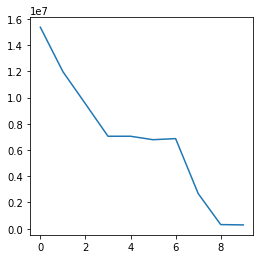

/usr/local/lib/python3.8/dist-packages/sklearn/manifold/_t_sne.py:780: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/usr/local/lib/python3.8/dist-packages/sklearn/manifold/_t_sne.py:790: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(


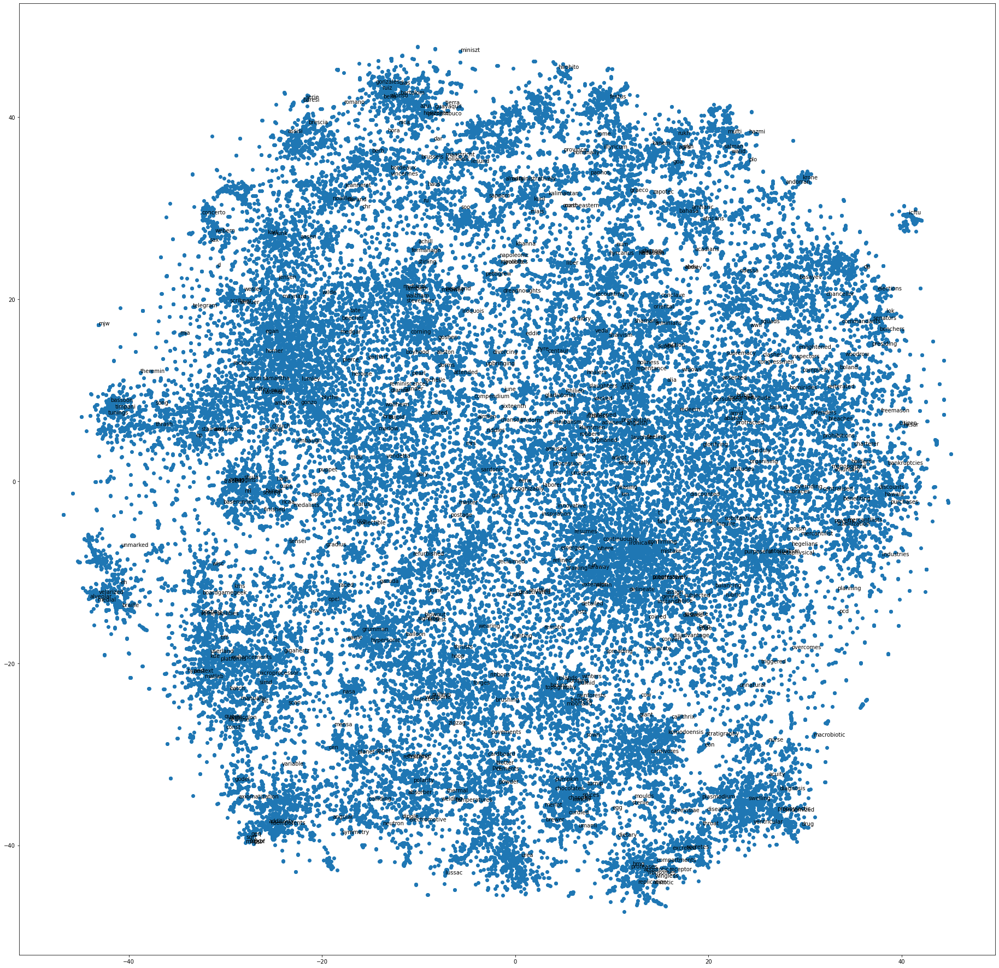

4.56043956043956 (415/91) score on analogy test.


<Figure size 432x288 with 0 Axes>

In [ ]:
model_name = "SG_300Vector_5Neg_10WindowSize_10Mincount_10Epochs_025LearningRate"
args = { "epochs": 10, "sg": 1, "min_count": 10, "negative": 5, "vector_size": 300, "window_size": 10, "learning_rate": 0.025}
results = models.run_and_evaluate_single_model(name=model_name, args=args, overwrite=GLOBAL_OVERWRITE, plot=True, run_eval=True)

SG_500Vector_5Neg_10WindowSize_10Mincount_10Epochs_025LearningRate.model
Loss after epoch 0: 15497660.0
Loss after epoch 1: 12018240.0
Loss after epoch 2: 9596472.0
Loss after epoch 3: 6967112.0
Loss after epoch 4: 6982920.0
Loss after epoch 5: 6906024.0
Loss after epoch 6: 6812908.0
Loss after epoch 7: 2548528.0
Loss after epoch 8: 310160.0
Loss after epoch 9: 278576.0
execution time: 354.27936441600013
Model training complete.  [15497660.0, 12018240.0, 9596472.0, 6967112.0, 6982920.0, 6906024.0, 6812908.0, 2548528.0, 310160.0, 278576.0]
[15497660.0, 12018240.0, 9596472.0, 6967112.0, 6982920.0, 6906024.0, 6812908.0, 2548528.0, 310160.0, 278576.0]
SG_500Vector_5Neg_10WindowSize_10Mincount_10Epochs_025LearningRate loss vs epoch plot


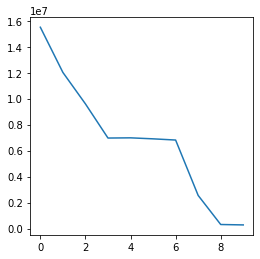

/usr/local/lib/python3.8/dist-packages/sklearn/manifold/_t_sne.py:780: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/usr/local/lib/python3.8/dist-packages/sklearn/manifold/_t_sne.py:790: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(


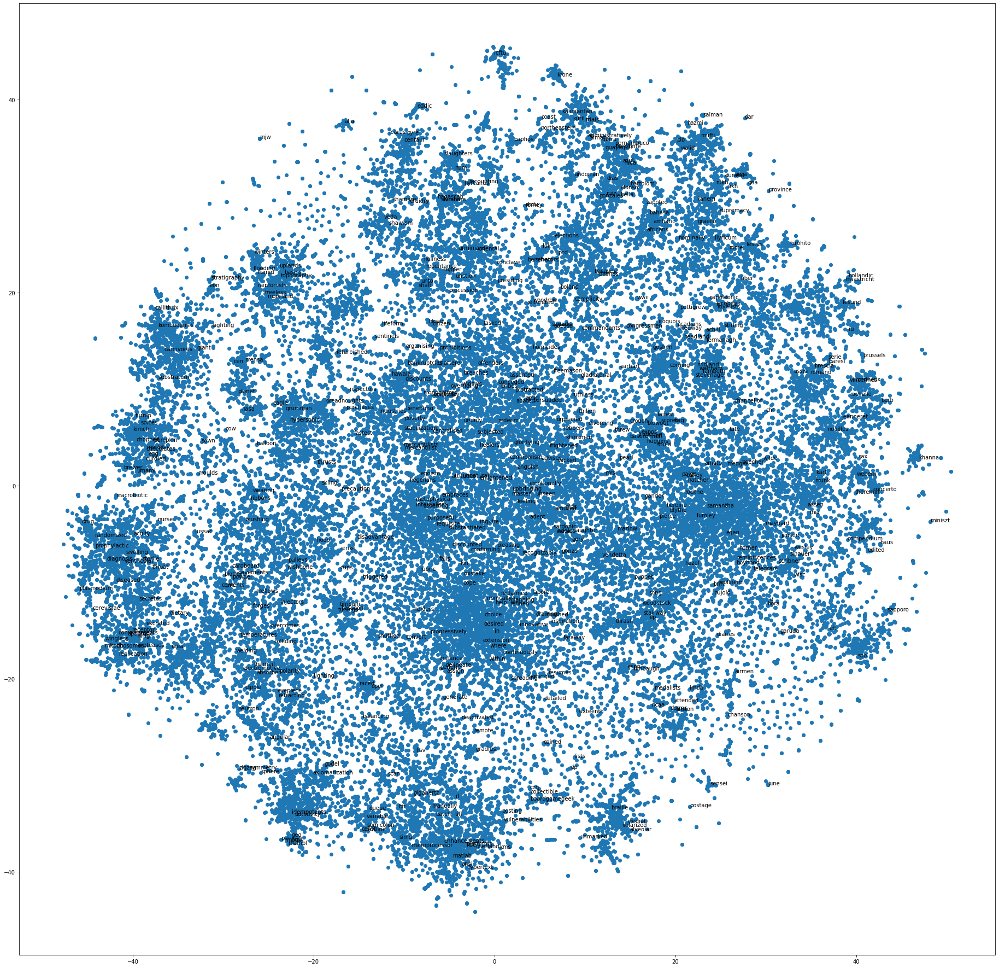

2.6934306569343067 (369/137) score on analogy test.


<Figure size 432x288 with 0 Axes>

In [11]:
model_name = "SG_500Vector_5Neg_10WindowSize_10Mincount_10Epochs_025LearningRate"
args = { "epochs": 10, "sg": 1, "min_count": 10, "negative": 5, "vector_size": 500, "window_size": 10, "learning_rate": 0.025}
results = models.run_and_evaluate_single_model(name=model_name, args=args, overwrite=GLOBAL_OVERWRITE, plot=True, run_eval=True)

SG_300Vector_HSM_10WindowSize_100Mincount_10Epochs.model
Loss after epoch 0: 14715661.0
Loss after epoch 1: 11674559.0
Loss after epoch 2: 9898096.0
Loss after epoch 3: 7076884.0
Loss after epoch 4: 6896776.0
Loss after epoch 5: 7055068.0
Loss after epoch 6: 7097476.0
Loss after epoch 7: 2831320.0
Loss after epoch 8: 204128.0
Loss after epoch 9: 171864.0
execution time: 266.1241055819992
Model training complete.  [14715661.0, 11674559.0, 9898096.0, 7076884.0, 6896776.0, 7055068.0, 7097476.0, 2831320.0, 204128.0, 171864.0]
[14715661.0, 11674559.0, 9898096.0, 7076884.0, 6896776.0, 7055068.0, 7097476.0, 2831320.0, 204128.0, 171864.0]
SG_300Vector_HSM_10WindowSize_100Mincount_10Epochs loss vs epoch plot


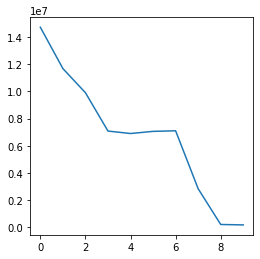

/usr/local/lib/python3.8/dist-packages/sklearn/manifold/_t_sne.py:780: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/usr/local/lib/python3.8/dist-packages/sklearn/manifold/_t_sne.py:790: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(


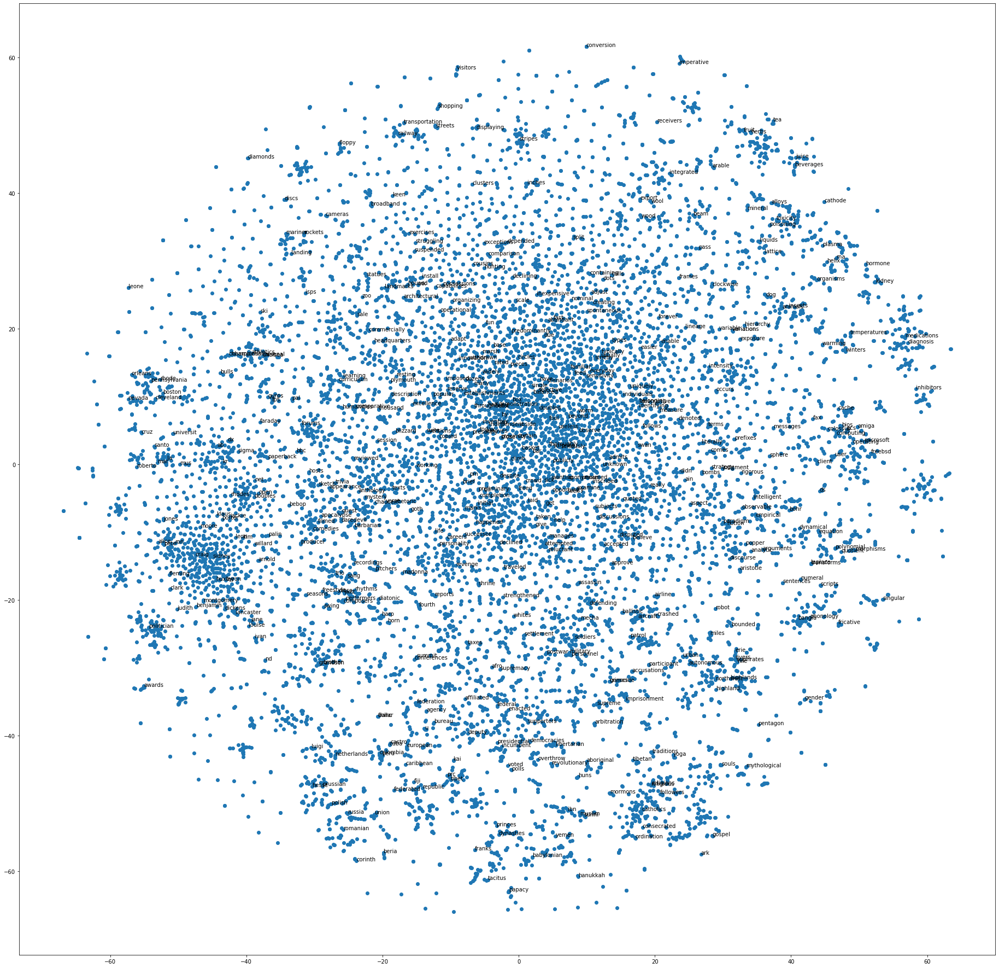

5.486486486486487 (203/37) score on analogy test.


<Figure size 432x288 with 0 Axes>

In [ ]:
model_name = "SG_300Vector_HSM_10WindowSize_100Mincount_10Epochs"
args = { "epochs": 10, "sg": 1, "hs": 1,"min_count": 100, "vector_size": 300, "window_size": 10}
results = models.run_and_evaluate_single_model(name=model_name, args=args, overwrite=GLOBAL_OVERWRITE, plot=True, run_eval=True)

SG_300Vector_HSM_10WindowSize_10Mincount_10Epochs.model
Loss after epoch 0: 15678622.0
Loss after epoch 1: 11916760.0
Loss after epoch 2: 9481046.0
Loss after epoch 3: 7088064.0
Loss after epoch 4: 6898084.0
Loss after epoch 5: 6848096.0
Loss after epoch 6: 6785516.0
Loss after epoch 7: 2627172.0
Loss after epoch 8: 319632.0
Loss after epoch 9: 275600.0
execution time: 271.55451327899937
Model training complete.  [15678622.0, 11916760.0, 9481046.0, 7088064.0, 6898084.0, 6848096.0, 6785516.0, 2627172.0, 319632.0, 275600.0]
[15678622.0, 11916760.0, 9481046.0, 7088064.0, 6898084.0, 6848096.0, 6785516.0, 2627172.0, 319632.0, 275600.0]
SG_300Vector_HSM_10WindowSize_10Mincount_10Epochs loss vs epoch plot


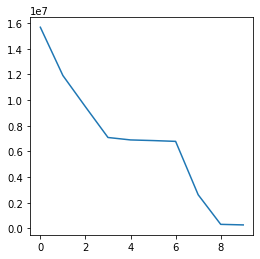

/usr/local/lib/python3.8/dist-packages/sklearn/manifold/_t_sne.py:780: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/usr/local/lib/python3.8/dist-packages/sklearn/manifold/_t_sne.py:790: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(


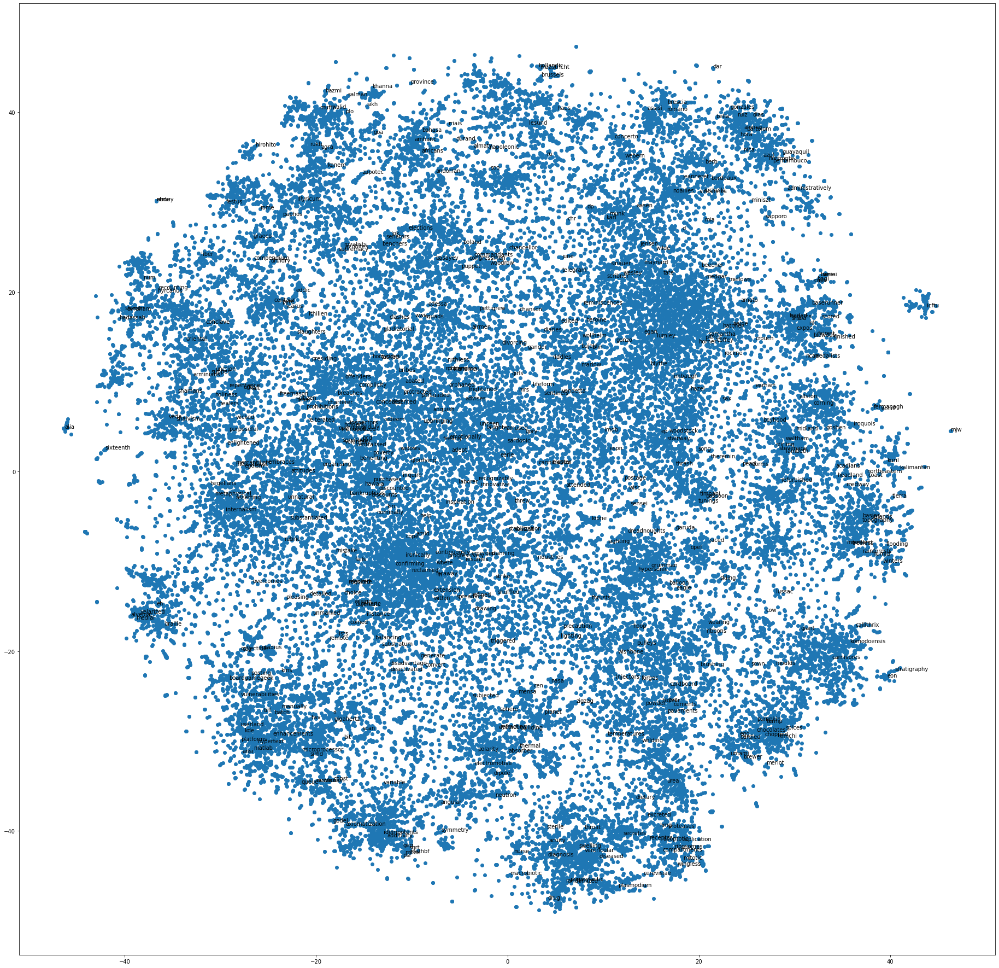

3.912621359223301 (403/103) score on analogy test.


<Figure size 432x288 with 0 Axes>

In [ ]:
model_name = "SG_300Vector_HSM_10WindowSize_10Mincount_10Epochs"
args = { "epochs": 10, "sg": 1, "hs": 1,"min_count": 10, "vector_size": 300, "window_size": 10}
results = models.run_and_evaluate_single_model(name=model_name, args=args, overwrite=GLOBAL_OVERWRITE, plot=True, run_eval=True)

SG_10Vector_HSM_10WindowSize_10Mincount_10Epochs.model
Loss after epoch 0: 15659664.0
Loss after epoch 1: 12349256.0
Loss after epoch 2: 8872888.0
Loss after epoch 3: 7067916.0
Loss after epoch 4: 6635908.0
Loss after epoch 5: 7124224.0
Loss after epoch 6: 7026020.0
Loss after epoch 7: 2580508.0
Loss after epoch 8: 275888.0
Loss after epoch 9: 246800.0
execution time: 121.6311269959997
Model training complete.  [15659664.0, 12349256.0, 8872888.0, 7067916.0, 6635908.0, 7124224.0, 7026020.0, 2580508.0, 275888.0, 246800.0]
[15659664.0, 12349256.0, 8872888.0, 7067916.0, 6635908.0, 7124224.0, 7026020.0, 2580508.0, 275888.0, 246800.0]
SG_10Vector_HSM_10WindowSize_10Mincount_10Epochs loss vs epoch plot


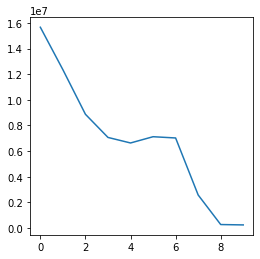

/usr/local/lib/python3.8/dist-packages/sklearn/manifold/_t_sne.py:780: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/usr/local/lib/python3.8/dist-packages/sklearn/manifold/_t_sne.py:790: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(


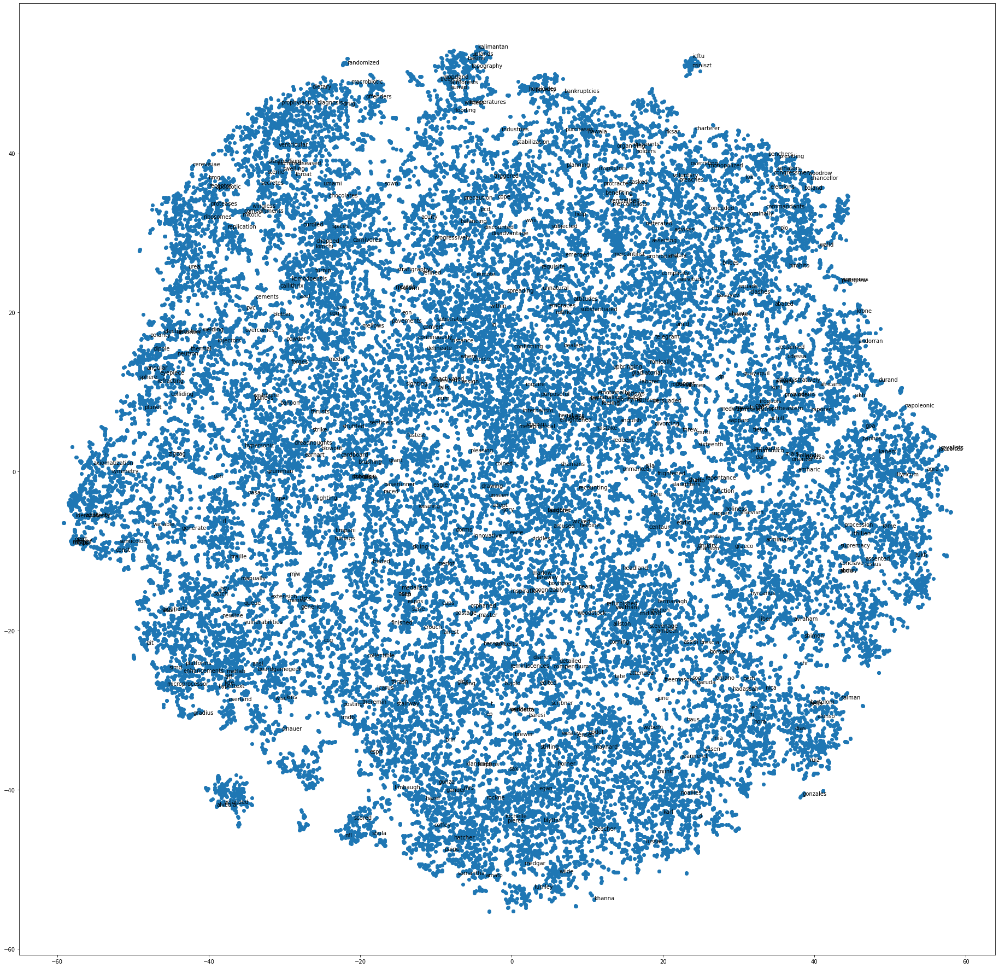

0.020161290322580645 (10/496) score on analogy test.


<Figure size 432x288 with 0 Axes>

In [12]:
model_name = "SG_10Vector_HSM_10WindowSize_10Mincount_10Epochs"
args = { "epochs": 10, "sg": 1, "hs": 1,"min_count": 10, "vector_size": 10, "window_size": 10}
results = models.run_and_evaluate_single_model(name=model_name, args=args, overwrite=GLOBAL_OVERWRITE, plot=True, run_eval=True)

SG_50Vector_HSM_10WindowSize_10Mincount_10Epochs.model
Loss after epoch 0: 15662541.0
Loss after epoch 1: 12050361.0
Loss after epoch 2: 9379418.0
Loss after epoch 3: 6928084.0
Loss after epoch 4: 6941164.0
Loss after epoch 5: 7299564.0
Loss after epoch 6: 6795860.0
Loss after epoch 7: 2282568.0
Loss after epoch 8: 328664.0
Loss after epoch 9: 294968.0
execution time: 171.95961016699948
Model training complete.  [15662541.0, 12050361.0, 9379418.0, 6928084.0, 6941164.0, 7299564.0, 6795860.0, 2282568.0, 328664.0, 294968.0]
[15662541.0, 12050361.0, 9379418.0, 6928084.0, 6941164.0, 7299564.0, 6795860.0, 2282568.0, 328664.0, 294968.0]
SG_50Vector_HSM_10WindowSize_10Mincount_10Epochs loss vs epoch plot


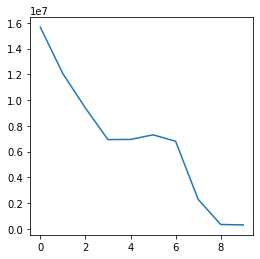

/usr/local/lib/python3.8/dist-packages/sklearn/manifold/_t_sne.py:780: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/usr/local/lib/python3.8/dist-packages/sklearn/manifold/_t_sne.py:790: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(


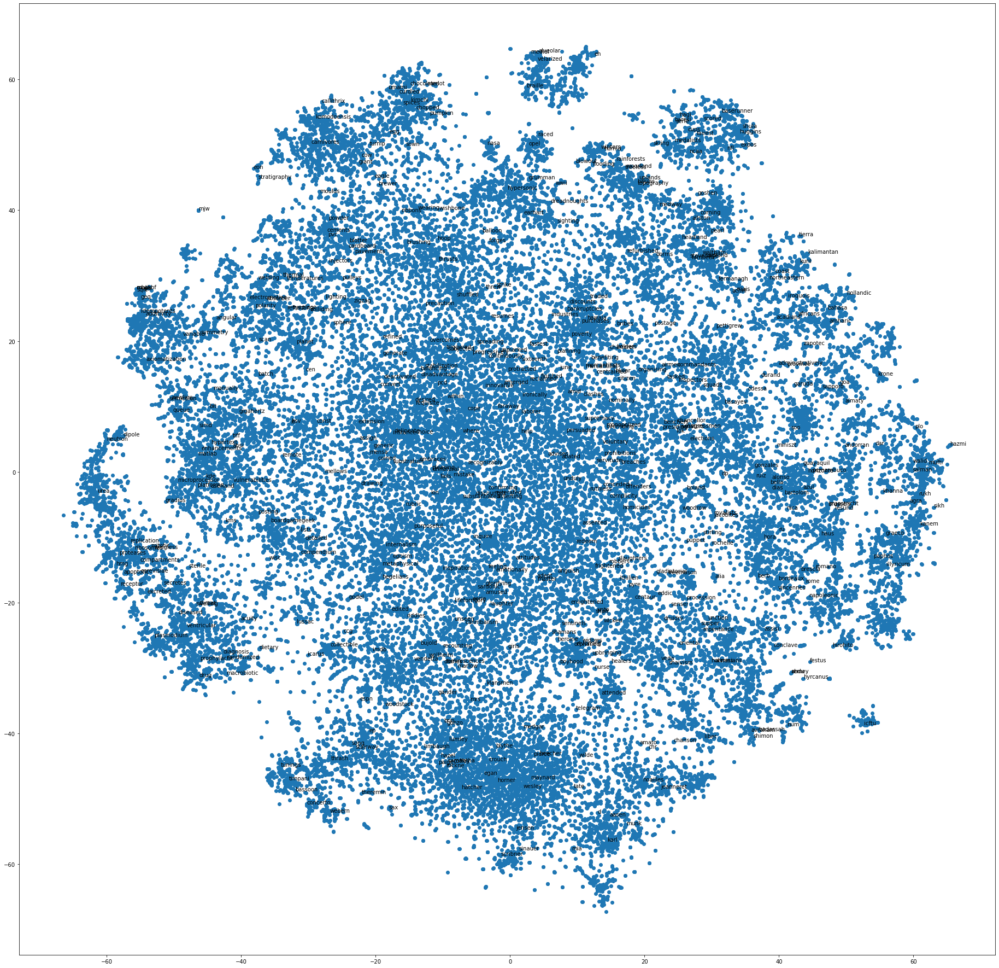

0.9312977099236641 (244/262) score on analogy test.


<Figure size 432x288 with 0 Axes>

In [13]:
model_name = "SG_50Vector_HSM_10WindowSize_10Mincount_10Epochs"
args = { "epochs": 10, "sg": 1, "hs": 1,"min_count": 10, "vector_size": 50, "window_size": 10}
results = models.run_and_evaluate_single_model(name=model_name, args=args, overwrite=GLOBAL_OVERWRITE, plot=True, run_eval=True)

SG_1000Vector_HSM_10WindowSize_10Mincount_10Epochs.model
Loss after epoch 0: 15598231.0
Loss after epoch 1: 12029927.0
Loss after epoch 2: 9558670.0
Loss after epoch 3: 7186796.0
Loss after epoch 4: 7100840.0
Loss after epoch 5: 6889164.0
Loss after epoch 6: 6763232.0
Loss after epoch 7: 2209324.0
Loss after epoch 8: 290976.0
Loss after epoch 9: 241248.0
execution time: 498.6282590640003
Model training complete.  [15598231.0, 12029927.0, 9558670.0, 7186796.0, 7100840.0, 6889164.0, 6763232.0, 2209324.0, 290976.0, 241248.0]
[15598231.0, 12029927.0, 9558670.0, 7186796.0, 7100840.0, 6889164.0, 6763232.0, 2209324.0, 290976.0, 241248.0]
SG_1000Vector_HSM_10WindowSize_10Mincount_10Epochs loss vs epoch plot


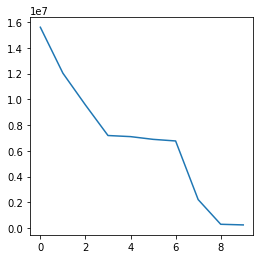

/usr/local/lib/python3.8/dist-packages/sklearn/manifold/_t_sne.py:780: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/usr/local/lib/python3.8/dist-packages/sklearn/manifold/_t_sne.py:790: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(


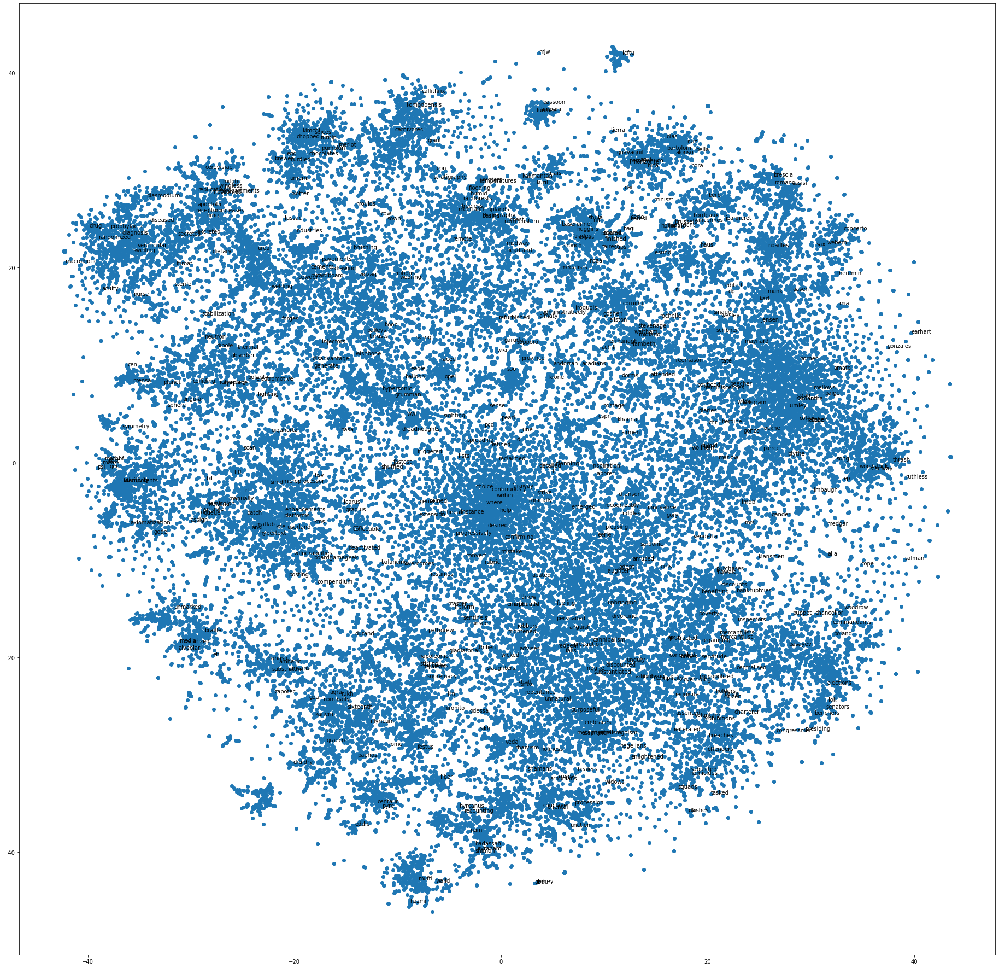

1.1440677966101696 (270/236) score on analogy test.


<Figure size 432x288 with 0 Axes>

In [14]:
model_name = "SG_1000Vector_HSM_10WindowSize_10Mincount_10Epochs"
args = { "epochs": 10, "sg": 1, "hs": 1,"min_count": 10, "vector_size": 1000, "window_size": 10}
results = models.run_and_evaluate_single_model(name=model_name, args=args, overwrite=GLOBAL_OVERWRITE, plot=True, run_eval=True)

SG_100Vector_HSM_10WindowSize_1Mincount_10Epochs.model
Loss after epoch 0: 15655763.0
Loss after epoch 1: 11704889.0
Loss after epoch 2: 9338812.0
Loss after epoch 3: 6510516.0
Loss after epoch 4: 6561468.0
Loss after epoch 5: 6373460.0
Loss after epoch 6: 6490592.0
Loss after epoch 7: 4589836.0
Loss after epoch 8: 350792.0
Loss after epoch 9: 329648.0
execution time: 180.74226726300003
Model training complete.  [15655763.0, 11704889.0, 9338812.0, 6510516.0, 6561468.0, 6373460.0, 6490592.0, 4589836.0, 350792.0, 329648.0]
[15655763.0, 11704889.0, 9338812.0, 6510516.0, 6561468.0, 6373460.0, 6490592.0, 4589836.0, 350792.0, 329648.0]
SG_100Vector_HSM_10WindowSize_1Mincount_10Epochs loss vs epoch plot


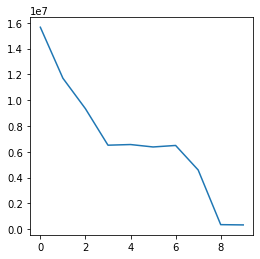

/usr/local/lib/python3.8/dist-packages/sklearn/manifold/_t_sne.py:780: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/usr/local/lib/python3.8/dist-packages/sklearn/manifold/_t_sne.py:790: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(


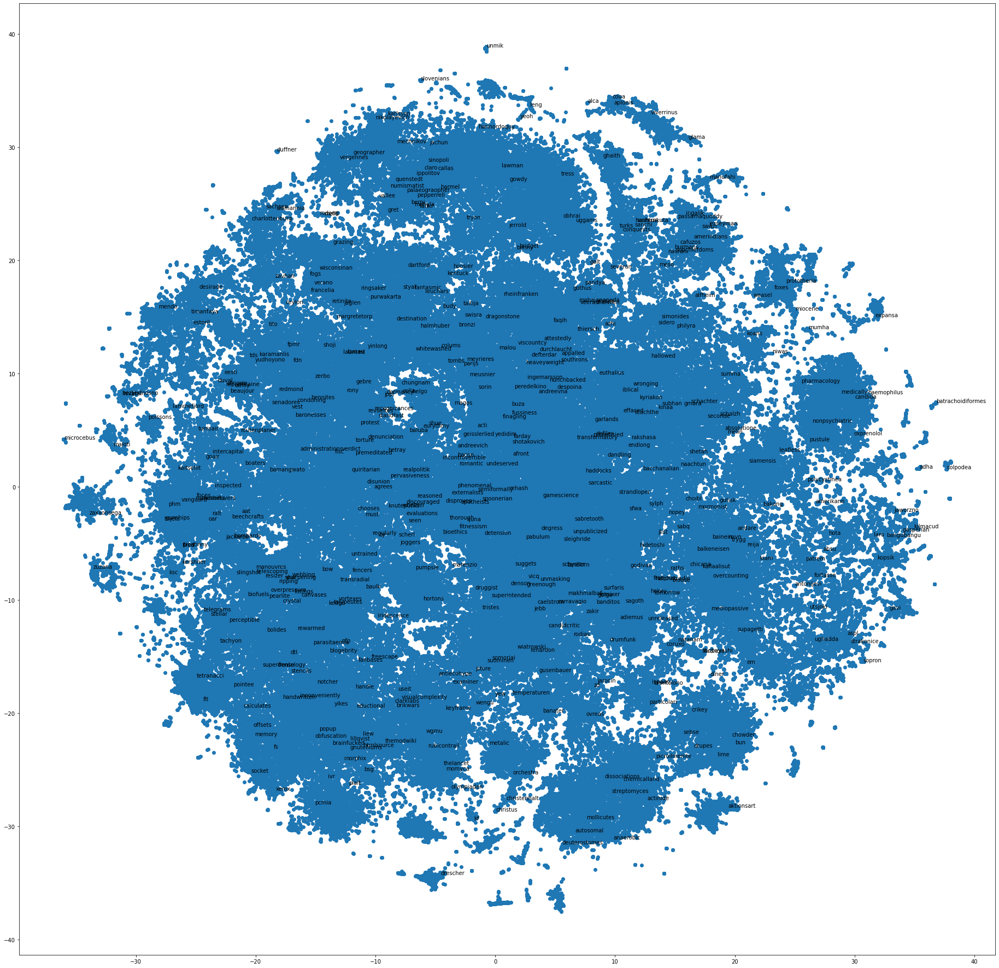

2.3509933774834435 (355/151) score on analogy test.


<Figure size 432x288 with 0 Axes>

In [15]:
model_name = "SG_100Vector_HSM_10WindowSize_1Mincount_10Epochs"
args = { "epochs": 10, "sg": 1, "hs": 1,"min_count": 1, "vector_size": 100, "window_size": 10}
results = models.run_and_evaluate_single_model(name=model_name, args=args, overwrite=GLOBAL_OVERWRITE, plot=True, run_eval=True)

In [16]:
model_name = "SG_300Vector_25Negs_25WindowSize_50Mincount_10Epochs"
args = { "epochs": 10, "sg": 1, "negative": 25, "min_count": 50, "vector_size": 300, "window_size": 25}
results = models.run_and_evaluate_single_model(name=model_name, args=args, overwrite=GLOBAL_OVERWRITE, plot=False, run_eval=True)

SG_300Vector_25Negs_25WindowSize_50Mincount_10Epochs.model
Loss after epoch 0: 43017644.0
Loss after epoch 1: 30857340.0
Loss after epoch 2: 16804288.0
Loss after epoch 3: 16431128.0
Loss after epoch 4: 16458512.0
Loss after epoch 5: 10648816.0
Loss after epoch 6: 0.0
Loss after epoch 7: 0.0
Loss after epoch 8: 0.0
Loss after epoch 9: 0.0
execution time: 2628.999411867999
Model training complete.  [43017644.0, 30857340.0, 16804288.0, 16431128.0, 16458512.0, 10648816.0, 0.0, 0.0, 0.0, 0.0]
6.6 (297/45) score on analogy test.


In [72]:
for item in results[1][1]['correct']:
  if item[1] == "FRANCE" and item[3] == "JAPAN":
    print(item)
  if item[1] == "FRANCE" and item[3] == "ITALY":
    print(item)
  if item[1] == "FRANCE" and item[3] == "ROME":
    print(item)
  if item[1] == "BIGGER":
    print(item)
print("****************")
for item in results[1][1]['incorrect']:
  if item[1] == "FRANCE" and item[3] == "JAPAN":
    print(item)
  if item[1] == "FRANCE" and item[3] == "ITALY":
    print(item)
  if item[1] == "FRANCE" and item[3] == "ROME":
    print(item)
  if item[1] == "BIGGER":
    print(item)
print("CANBERRA" in vocab)
model = models.create_model("SG_300Vector_25Negs_25WindowSize_50Mincount_10Epochs", overwrite=False, args=args)

('PARIS', 'FRANCE', 'ROME', 'ITALY')
('PARIS', 'FRANCE', 'TOKYO', 'JAPAN')
****************
False
SG_300Vector_25Negs_25WindowSize_50Mincount_10Epochs.model
Loaded existing model: SG_300Vector_25Negs_25WindowSize_50Mincount_10Epochs.model


In [163]:
def analogy(worda, wordb, wordc):
    result = model.wv.most_similar(negative=[worda], 
                                positive=[wordb, wordc])
    return result[0][0]

countries = ['italy', 'japan', 'florida']
foods = [analogy('france', 'paris', country) for country in countries]
result = zip(countries,foods)
for item in result:
  print(item)

compare_terms = ['small', 'cold', 'quick']
source_relations = [analogy('big', 'bigger', compare_term) for compare_term in compare_terms]
result = zip(compare_terms, source_relations)
for item in result:
  print(item)


# substituted boston for kona
compare_terms = ['baltimore', 'dallas', 'boston']
source_relations = [analogy('miami', 'florida', compare_term) for compare_term in compare_terms]
result = zip(compare_terms, source_relations)
for item in result:
  print(item)
  
# substituded descartes for messi
compare_terms = ['descartes', 'mozart', 'picasso']
source_relations = [analogy('einstein', 'scientist', compare_term) for compare_term in compare_terms]
result = zip(compare_terms, source_relations)
for item in result:
  print(item)

# thatcher substituded for berlusconi, trudeau for merkel, gorbachev for koizumi, kennedy for sarkozy
compare_terms = ['thatcher', 'trudeau', 'gorbachev']
source_relations = [analogy('kennedy', 'usa', compare_term) for compare_term in compare_terms]
result = zip(compare_terms, source_relations)
for item in result:
  print(item)

compare_terms = ['zinc', 'gold', 'uranium']
source_relations = [analogy('copper', 'cu', compare_term) for compare_term in compare_terms]
result = zip(compare_terms, source_relations)
for item in result:
  print(item)

compare_terms = ['google', 'ibm', 'apple']
source_relations = [analogy('microsoft', 'windows', compare_term) for compare_term in compare_terms]
result = zip(compare_terms, source_relations)
for item in result:
  print(item)

# there was no way to get this one done meaningfully.
# Necessary words weren't in the vocabulary, and substitues
# were misinterpreted, like getting gate back when subsituting gates for ballmer
# or employees for jobs (if apple was substituded for microsoft)
#compare_terms = ['google', 'ibm', 'apple']
#source_relations = [analogy('microsoft', 'ballmer', compare_term) for compare_term in compare_terms]
#result = zip(compare_terms, source_relations)
#for item in result:
#  print(item)

compare_terms = ['germany', 'france', 'usa']
source_relations = [analogy('japan', 'fish', compare_term) for compare_term in compare_terms]
result = zip(compare_terms, source_relations)
for item in result:
  print(item)


('italy', 'rome')
('japan', 'tokyo')
('florida', 'miami')
('small', 'smaller')
('cold', 'cooler')
('quick', 'lot')
('baltimore', 'maryland')
('dallas', 'texas')
('boston', 'massachusetts')
('descartes', 'philosopher')
('mozart', 'composer')
('picasso', 'painter')
('thatcher', 'uk')
('trudeau', 'canada')
('gorbachev', 'ussr')
('zinc', 'chloride')
('gold', 'cma')
('uranium', 'plutonium')
('google', 'search')
('ibm', 'pc')
('apple', 'macintosh')
('germany', 'meat')
('france', 'tuna')
('usa', 'meat')


[Google Embeddings Projector](http://projector.tensorflow.org/)